In [1]:
import math
import time

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px
import seaborn as sns
from catboost import CatBoostClassifier

from sklearn.calibration import CalibratedClassifierCV
from sklearn.ensemble import (ExtraTreesClassifier, ExtraTreesRegressor,
                              GradientBoostingRegressor,
                              RandomForestClassifier, RandomForestRegressor,
                              StackingClassifier)
from sklearn.linear_model import (LinearRegression, LogisticRegression,
                                  SGDClassifier, SGDRegressor)

from sklearn.metrics import (accuracy_score, balanced_accuracy_score,
                             classification_report, confusion_matrix, f1_score,
                             matthews_corrcoef, mean_absolute_error,
                             mean_squared_error, r2_score)
from sklearn.model_selection import KFold, StratifiedKFold, cross_val_predict
from sklearn.naive_bayes import MultinomialNB
from sklearn.neighbors import KNeighborsClassifier, KNeighborsRegressor
from sklearn.neural_network import MLPClassifier, MLPRegressor
from sklearn.preprocessing import MinMaxScaler, RobustScaler
from sklearn.svm import LinearSVC, LinearSVR
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor

from xgboost import XGBClassifier, XGBRegressor

In [2]:
pd.set_option('display.max_columns', None)

In [3]:
carne = pd.read_excel('../entrada/banco_carne_geracao_renda_pof17_v2.xls')
carne.columns

Index(['id', 'idfam', 'UF', 'ESTRATO_POF', 'TIPO_SITUACAO_REG', 'COD_UPA',
       'NUM_DOM', 'NUM_UC', 'COD_INFORMANTE', 'V0306', 'V0403', 'V0404',
       'V0405', 'V0406', 'V0407', 'V0409', 'V0410', 'V0411', 'V0412', 'V0414',
       'ANOS_ESTUDO', 'PESO', 'PESO_FINAL', 'RENDA_TOTAL', 'dom', '_merge',
       'V0201', 'V0202', 'V0203', 'V0204', 'V0205', 'V0206', 'V0207', 'V0209',
       'V02111', 'V02113', 'V0212', 'V0213', 'V02141', 'V0215', 'V02161',
       'V02162', 'V02163', 'V02164', 'V0217', 'V0220', 'V0221', 'V6199', 'san',
       '_merge6', 'idade', 'V04023', 'sexo', 'V0425', 'rpc', 'bov2_final',
       'cp_final', 'porco_final', 'cordeiro_final', 'frango_final',
       'peixe_final', 'caca_mi_final', 'ENERGIA_KCAL', 'seguranca_alimentar',
       'bov_adj', 'cp_adj', 'porco_adj', 'cordeiro_adj', 'frango_adj',
       'peixe_adj', 'caca_adj', 'meat_total_crude', 'meat_total_adj',
       'geracoes', '_merge7', 'supplem', 'dieta', 'V71051', 'V71052', 'V71053',
       'V71054', 'V710

In [4]:
# domt show floats as scientific notation
pd.set_option('display.float_format', lambda x: '%.3f' % x)
pd.set_option('display.max_columns', 100)

In [5]:

carne['id'] = carne['id'].astype(str)
carne.head()


,id,idfam,UF,ESTRATO_POF,TIPO_SITUACAO_REG,COD_UPA,NUM_DOM,NUM_UC,COD_INFORMANTE,V0306,V0403,V0404,V0405,V0406,V0407,V0409,V0410,V0411,V0412,V0414,ANOS_ESTUDO,PESO,PESO_FINAL,RENDA_TOTAL,dom,_merge,V0201,V0202,V0203,V0204,V0205,V0206,V0207,V0209,V02111,V02113,V0212,V0213,V02141,V0215,V02161,V02162,V02163,V02164,V0217,V0220,V0221,V6199,san,_merge6,idade,V04023,sexo,V0425,rpc,bov2_final,cp_final,porco_final,cordeiro_final,frango_final,peixe_final,caca_mi_final,ENERGIA_KCAL,seguranca_alimentar,bov_adj,cp_adj,porco_adj,cordeiro_adj,frango_adj,peixe_adj,caca_adj,meat_total_crude,meat_total_adj,geracoes,_merge7,supplem,dieta,V71051,V71052,V71053,V71054,V71055,V71056,gravida,amamenta,pesokg,altura,imc
0,11000001602101,110000016021,11,1101,1,110000016,2,1,1,1,64,1,4,2,1.000,0.000,1.000,0.000,NaN,1,5,449.912,690.884,3855.340,110000016020,both in master and using data,1,1,1,3,6,2,1,1,2,NaN,2.000,1,1,1.000,1,2,1,2,2,1,1,1,1,both in master and using data,64,1953,Homem,Antigo primário,1285.110,83.125,0.000,0.000,0.000,0.000,0.000,0.000,1382.300,SAN,60.135,0.000,0.000,0.000,0.000,0.000,0.000,83.125,60.135,baby boomers,both in master and using data,2,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,64,154,26.986
1,11000001602102,110000016021,11,1101,1,110000016,2,1,2,2,61,2,4,2,1.000,1.000,1.000,0.000,NaN,1,6,449.912,690.884,3855.340,110000016020,both in master and using data,1,1,1,3,6,2,1,1,2,NaN,2.000,1,1,1.000,1,2,1,2,2,1,1,1,1,both in master and using data,61,1956,Mulher,Antigo primário,1285.110,66.500,0.000,0.000,0.000,0.000,0.000,0.000,1228.800,SAN,54.118,0.000,0.000,0.000,0.000,0.000,0.000,66.500,54.118,baby boomers,both in master and using data,2,2,NaN,NaN,NaN,NaN,NaN,NaN,2.000,2.000,53,144,25.559
2,11000001602103,110000016021,11,1101,1,110000016,2,1,3,6,41,1,4,2,1.000,1.000,1.000,0.000,NaN,1,12,449.912,690.884,3855.340,110000016020,both in master and using data,1,1,1,3,6,2,1,1,2,NaN,2.000,1,1,1.000,1,2,1,2,2,1,1,1,1,both in master and using data,41,1976,Homem,Regular do ensino médio,1285.110,166.250,0.000,0.000,0.000,0.000,0.000,0.000,1351.950,SAN,122.971,0.000,0.000,0.000,0.000,0.000,0.000,166.250,122.971,geracao X,both in master and using data,2,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,80,180,24.691
3,11000001607101,110000016071,11,1101,1,110000016,7,1,1,1,37,1,4,2,1.000,4.000,1.000,1.000,2.000,1,12,449.912,690.884,6253.240,110000016070,both in master and using data,1,1,1,1,8,3,1,1,2,NaN,2.000,1,1,1.000,1,2,1,2,1,1,1,1,1,both in master and using data,37,1980,Homem,Regular do ensino médio,1250.650,82.431,50.000,0.000,0.000,0.000,0.000,0.000,2012.395,SAN,40.962,24.846,0.000,0.000,0.000,0.000,0.000,132.431,65.808,geracao Y,both in master and using data,2,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,76,168,26.927
4,11000001607102,110000016071,11,1101,1,110000016,7,1,2,2,36,2,4,1,1.000,0.000,2.000,1.000,2.000,1,12,449.912,690.884,6253.240,110000016070,both in master and using data,1,1,1,1,8,3,1,1,2,NaN,2.000,1,1,1.000,1,2,1,2,1,1,1,1,1,both in master and using data,36,1981,Mulher,Regular do ensino médio,1250.650,41.215,25.000,0.000,0.000,0.000,0.000,0.000,1607.382,SAN,25.641,15.553,0.000,0.000,0.000,0.000,0.000,66.215,41.195,geracao Y,both in master and using data,1,2,NaN,NaN,NaN,NaN,NaN,NaN,2.000,2.000,58,145,27.586


In [6]:
# create a new column caled "pessoas_na_familia" that will count how many people live in each family (consider each family as a unique id from idfam)
carne['pessoas_na_familia'] = carne.groupby('idfam')['idfam'].transform('count')
carne['pessoas_na_familia'].value_counts()

pessoas_na_familia
2     15618
3     12330
4      7716
1      5371
5      3120
6      1122
7       448
8       272
9       126
10       30
11       11
Name: count, dtype: int64

In [7]:
dropping = [i for i in carne.columns if '_final' in i]
dropping += [i for i in carne.columns if '_merge' in i]
#dropping += ['meat_total_adj', 'meat_total_crude']
dropping += ['V71051', 'V71052', 'V71053', 'V71054', 'V71055', 'V71056'] # tipos de dieta, excluir
dropping += ['V04023'] # ano nascimento
#dropping += ['gravida', 'amamenta', 'pesokg', 'altura']
dropping += ['san', 'V6199']
dropping += ['V02113']
#dropping += ['PESO', 'COD_INFORMANTE', 'ESTRATO_POF', 'COD_UPA', 'NUM_DOM', 'NUM_UC', 'PESO_FINAL', 'rpc']
dropping += ['V0403', 'V0404', 'V0412', 'geracoes', 'V0425', 'V0411', 'V0215']
dropping += ['id', 'dom']
print(dropping)
df = carne.drop(columns=dropping).copy()
df




['bov2_final', 'cp_final', 'porco_final', 'cordeiro_final', 'frango_final', 'peixe_final', 'caca_mi_final', '_merge', '_merge6', '_merge7', 'V71051', 'V71052', 'V71053', 'V71054', 'V71055', 'V71056', 'V04023', 'san', 'V6199', 'V02113', 'V0403', 'V0404', 'V0412', 'geracoes', 'V0425', 'V0411', 'V0215', 'id', 'dom']


,idfam,UF,ESTRATO_POF,TIPO_SITUACAO_REG,COD_UPA,NUM_DOM,NUM_UC,COD_INFORMANTE,V0306,V0405,V0406,V0407,V0409,V0410,V0414,ANOS_ESTUDO,PESO,PESO_FINAL,RENDA_TOTAL,V0201,V0202,V0203,V0204,V0205,V0206,V0207,V0209,V02111,V0212,V0213,V02141,V02161,V02162,V02163,V02164,V0217,V0220,V0221,idade,sexo,rpc,ENERGIA_KCAL,seguranca_alimentar,bov_adj,cp_adj,porco_adj,cordeiro_adj,frango_adj,peixe_adj,caca_adj,meat_total_crude,meat_total_adj,supplem,dieta,gravida,amamenta,pesokg,altura,imc,pessoas_na_familia
0,110000016021,11,1101,1,110000016,2,1,1,1,4,2,1.000,0.000,1.000,1,5,449.912,690.884,3855.340,1,1,1,3,6,2,1,1,2,2.000,1,1,1,2,1,2,2,1,1,64,Homem,1285.110,1382.300,SAN,60.135,0.000,0.000,0.000,0.000,0.000,0.000,83.125,60.135,2,2,NaN,NaN,64,154,26.986,3
1,110000016021,11,1101,1,110000016,2,1,2,2,4,2,1.000,1.000,1.000,1,6,449.912,690.884,3855.340,1,1,1,3,6,2,1,1,2,2.000,1,1,1,2,1,2,2,1,1,61,Mulher,1285.110,1228.800,SAN,54.118,0.000,0.000,0.000,0.000,0.000,0.000,66.500,54.118,2,2,2.000,2.000,53,144,25.559,3
2,110000016021,11,1101,1,110000016,2,1,3,6,4,2,1.000,1.000,1.000,1,12,449.912,690.884,3855.340,1,1,1,3,6,2,1,1,2,2.000,1,1,1,2,1,2,2,1,1,41,Homem,1285.110,1351.950,SAN,122.971,0.000,0.000,0.000,0.000,0.000,0.000,166.250,122.971,2,2,NaN,NaN,80,180,24.691,3
3,110000016071,11,1101,1,110000016,7,1,1,1,4,2,1.000,4.000,1.000,1,12,449.912,690.884,6253.240,1,1,1,1,8,3,1,1,2,2.000,1,1,1,2,1,2,1,1,1,37,Homem,1250.650,2012.395,SAN,40.962,24.846,0.000,0.000,0.000,0.000,0.000,132.431,65.808,2,2,NaN,NaN,76,168,26.927,4
4,110000016071,11,1101,1,110000016,7,1,2,2,4,1,1.000,0.000,2.000,1,12,449.912,690.884,6253.240,1,1,1,1,8,3,1,1,2,2.000,1,1,1,2,1,2,1,1,1,36,Mulher,1250.650,1607.382,SAN,25.641,15.553,0.000,0.000,0.000,0.000,0.000,66.215,41.195,1,2,2.000,2.000,58,145,27.586,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46159,530044198031,53,5301,1,530044198,3,1,4,4,4,1,2.000,0.000,0.000,1,12,563.080,689.626,35197.600,2,1,3,2,11,3,1,1,3,1.000,1,1,1,2,1,2,4,1,1,17,Mulher,8799.400,2539.870,SAN,13.718,0.000,0.000,0.000,60.771,0.000,0.000,189.193,74.489,2,2,2.000,2.000,93,166,33.749,3
46160,530044198091,53,5301,1,530044198,9,1,1,1,4,1,2.000,1.000,1.000,1,15,563.080,689.626,31051.450,2,1,3,2,12,2,1,1,3,1.000,1,1,1,2,1,2,4,1,1,41,Mulher,10350.480,1099.733,SAN,0.000,0.000,0.000,0.000,103.255,12.730,0.000,127.553,115.985,2,1,2.000,2.000,86,163,32.369,2
46161,530044198091,53,5301,1,530044198,9,1,2,2,1,1,1.000,1.000,2.000,1,16,563.080,689.626,31051.450,2,1,3,2,12,2,1,1,3,1.000,1,1,1,2,1,2,4,1,1,52,Homem,10350.480,1459.200,SAN,0.000,7.281,0.000,0.000,0.000,68.222,0.000,110.175,75.504,2,2,NaN,NaN,64,163,24.088,2
46162,530044198111,53,5301,1,530044198,11,1,1,1,4,1,1.000,1.000,1.000,1,16,563.080,689.626,1569.030,2,1,3,1,4,1,1,1,1,1.000,1,1,1,2,1,2,3,1,1,25,Mulher,1569.030,2041.750,SAN,37.113,0.000,0.000,0.000,0.000,0.000,0.000,75.775,37.113,2,2,2.000,2.000,49,157,19.879,1


In [8]:
df.dropna(how='any')

,idfam,UF,ESTRATO_POF,TIPO_SITUACAO_REG,COD_UPA,NUM_DOM,NUM_UC,COD_INFORMANTE,V0306,V0405,V0406,V0407,V0409,V0410,V0414,ANOS_ESTUDO,PESO,PESO_FINAL,RENDA_TOTAL,V0201,V0202,V0203,V0204,V0205,V0206,V0207,V0209,V02111,V0212,V0213,V02141,V02161,V02162,V02163,V02164,V0217,V0220,V0221,idade,sexo,rpc,ENERGIA_KCAL,seguranca_alimentar,bov_adj,cp_adj,porco_adj,cordeiro_adj,frango_adj,peixe_adj,caca_adj,meat_total_crude,meat_total_adj,supplem,dieta,gravida,amamenta,pesokg,altura,imc,pessoas_na_familia
1,110000016021,11,1101,1,110000016,2,1,2,2,4,2,1.000,1.000,1.000,1,6,449.912,690.884,3855.340,1,1,1,3,6,2,1,1,2,2.000,1,1,1,2,1,2,2,1,1,61,Mulher,1285.110,1228.800,SAN,54.118,0.000,0.000,0.000,0.000,0.000,0.000,66.500,54.118,2,2,2.000,2.000,53,144,25.559,3
4,110000016071,11,1101,1,110000016,7,1,2,2,4,1,1.000,0.000,2.000,1,12,449.912,690.884,6253.240,1,1,1,1,8,3,1,1,2,2.000,1,1,1,2,1,2,1,1,1,36,Mulher,1250.650,1607.382,SAN,25.641,15.553,0.000,0.000,0.000,0.000,0.000,66.215,41.195,1,2,2.000,2.000,58,145,27.586,4
6,110000016071,11,1101,1,110000016,7,1,5,6,4,2,1.000,0.000,1.000,1,12,449.912,690.884,6253.240,1,1,1,1,8,3,1,1,2,2.000,1,1,1,2,1,2,1,1,1,19,Mulher,1250.650,1681.495,SAN,24.511,14.868,0.000,0.000,0.000,0.000,0.000,66.215,39.379,2,2,2.000,2.000,47,155,19.563,4
7,110000016121,11,1101,1,110000016,12,1,2,2,4,2,1.000,1.000,0.000,1,11,449.912,690.884,4353.510,1,1,1,1,6,3,2,1,1,2.000,1,1,1,2,2,2,3,1,1,32,Mulher,1088.380,1872.344,SAN,2.233,0.000,0.000,0.000,80.714,0.000,0.000,155.304,82.946,2,2,2.000,2.000,57,151,24.999,2
8,110000016121,11,1101,1,110000016,12,1,3,6,4,2,2.000,0.000,0.000,1,5,449.912,690.884,4353.510,1,1,1,1,6,3,2,1,1,2.000,1,1,1,2,2,2,3,1,1,14,Mulher,1088.380,2020.950,SAN,68.993,0.000,0.000,0.000,49.852,0.000,0.000,240.180,118.845,2,2,2.000,2.000,54,145,25.684,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46154,530044198021,53,5301,1,530044198,2,1,2,2,1,1,1.000,0.000,0.000,1,15,563.080,689.626,24739.800,2,1,3,2,10,3,1,1,3,1.000,1,1,1,2,1,2,4,1,1,50,Mulher,4947.960,1072.490,SAN,44.289,0.000,0.000,0.000,46.970,0.000,0.000,97.874,91.259,2,1,2.000,2.000,85,164,31.603,4
46158,530044198031,53,5301,1,530044198,3,1,3,4,4,1,2.000,0.000,0.000,1,8,563.080,689.626,35197.600,2,1,3,2,11,3,1,1,3,1.000,1,1,1,2,1,2,4,1,1,14,Mulher,8799.400,1832.710,SAN,19.011,0.000,0.000,0.000,56.146,0.000,0.000,137.743,75.158,2,2,2.000,2.000,52,161,20.061,3
46159,530044198031,53,5301,1,530044198,3,1,4,4,4,1,2.000,0.000,0.000,1,12,563.080,689.626,35197.600,2,1,3,2,11,3,1,1,3,1.000,1,1,1,2,1,2,4,1,1,17,Mulher,8799.400,2539.870,SAN,13.718,0.000,0.000,0.000,60.771,0.000,0.000,189.193,74.489,2,2,2.000,2.000,93,166,33.749,3
46160,530044198091,53,5301,1,530044198,9,1,1,1,4,1,2.000,1.000,1.000,1,15,563.080,689.626,31051.450,2,1,3,2,12,2,1,1,3,1.000,1,1,1,2,1,2,4,1,1,41,Mulher,10350.480,1099.733,SAN,0.000,0.000,0.000,0.000,103.255,12.730,0.000,127.553,115.985,2,1,2.000,2.000,86,163,32.369,2


In [9]:
df['V0409'] = df['V0409'].fillna(0).astype(int)
df['V0410'] = df['V0410'].fillna(0).astype(int)
df['V0212'] = df['V0212'].fillna(0).astype(int)


In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 46164 entries, 0 to 46163
Data columns (total 60 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   idfam                46164 non-null  int64  
 1   UF                   46164 non-null  int64  
 2   ESTRATO_POF          46164 non-null  int64  
 3   TIPO_SITUACAO_REG    46164 non-null  int64  
 4   COD_UPA              46164 non-null  int64  
 5   NUM_DOM              46164 non-null  int64  
 6   NUM_UC               46164 non-null  int64  
 7   COD_INFORMANTE       46164 non-null  int64  
 8   V0306                46164 non-null  int64  
 9   V0405                46164 non-null  int64  
 10  V0406                46164 non-null  int64  
 11  V0407                46150 non-null  float64
 12  V0409                46164 non-null  int64  
 13  V0410                46164 non-null  int64  
 14  V0414                46164 non-null  int64  
 15  ANOS_ESTUDO          46164 non-null 

In [11]:
df.drop(columns=['gravida', 'amamenta'], inplace=True)
df.reset_index(drop=True, inplace=True)
df.shape

(46164, 58)

In [12]:
print(df.shape)
df = df.dropna(how='any').copy()
print(df.shape)

# Reduzindo o tamanho porque a relação custo benefício de tirar as colunas dos NaNs não compensa. É melhor manter as colunas e eliminar as 4% de linhas finais (já que vamos considerar 1 pessoa por familia)
# < 0.0001% das familias fica de fora

(46164, 58)
(46150, 58)


In [13]:
df.columns

Index(['idfam', 'UF', 'ESTRATO_POF', 'TIPO_SITUACAO_REG', 'COD_UPA', 'NUM_DOM',
       'NUM_UC', 'COD_INFORMANTE', 'V0306', 'V0405', 'V0406', 'V0407', 'V0409',
       'V0410', 'V0414', 'ANOS_ESTUDO', 'PESO', 'PESO_FINAL', 'RENDA_TOTAL',
       'V0201', 'V0202', 'V0203', 'V0204', 'V0205', 'V0206', 'V0207', 'V0209',
       'V02111', 'V0212', 'V0213', 'V02141', 'V02161', 'V02162', 'V02163',
       'V02164', 'V0217', 'V0220', 'V0221', 'idade', 'sexo', 'rpc',
       'ENERGIA_KCAL', 'seguranca_alimentar', 'bov_adj', 'cp_adj', 'porco_adj',
       'cordeiro_adj', 'frango_adj', 'peixe_adj', 'caca_adj',
       'meat_total_crude', 'meat_total_adj', 'supplem', 'dieta', 'pesokg',
       'altura', 'imc', 'pessoas_na_familia'],
      dtype='object')

In [14]:
df = df[['idfam', 'UF', 'TIPO_SITUACAO_REG', 
       'COD_INFORMANTE', 'V0405', 
       'V0414', 'ANOS_ESTUDO', 'idade', 'sexo', 'seguranca_alimentar', 'bov_adj', 'cp_adj', 'porco_adj',
       'cordeiro_adj', 'frango_adj', 'peixe_adj', 'caca_adj',
       'meat_total_adj', 'supplem', 'dieta',
       'imc', 'pessoas_na_familia']] # 'amamenta', 'pesokg', 'altura', 

In [15]:
df_renda = pd.read_parquet('saida/dados_8c_yes_onehot_corrigido.parquet')
df_renda = df_renda[['idfam', 'categoria_renda_corrigida']]

df = df.merge(df_renda, on='idfam', how='inner')

In [16]:
df

,idfam,UF,TIPO_SITUACAO_REG,COD_INFORMANTE,V0405,V0414,ANOS_ESTUDO,idade,sexo,seguranca_alimentar,bov_adj,cp_adj,porco_adj,cordeiro_adj,frango_adj,peixe_adj,caca_adj,meat_total_adj,supplem,dieta,imc,pessoas_na_familia,categoria_renda_corrigida
0,110000016021,11,1,1,4,1,5,64,Homem,SAN,60.135,0.000,0.000,0.000,0.000,0.000,0.000,60.135,2,2,26.986,3,4
1,110000016021,11,1,2,4,1,6,61,Mulher,SAN,54.118,0.000,0.000,0.000,0.000,0.000,0.000,54.118,2,2,25.559,3,4
2,110000016021,11,1,3,4,1,12,41,Homem,SAN,122.971,0.000,0.000,0.000,0.000,0.000,0.000,122.971,2,2,24.691,3,4
3,110000016071,11,1,1,4,1,12,37,Homem,SAN,40.962,24.846,0.000,0.000,0.000,0.000,0.000,65.808,2,2,26.927,4,4
4,110000016071,11,1,2,4,1,12,36,Mulher,SAN,25.641,15.553,0.000,0.000,0.000,0.000,0.000,41.195,1,2,27.586,4,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46145,530044198031,53,1,4,4,1,12,17,Mulher,SAN,13.718,0.000,0.000,0.000,60.771,0.000,0.000,74.489,2,2,33.749,3,7
46146,530044198091,53,1,1,4,1,15,41,Mulher,SAN,0.000,0.000,0.000,0.000,103.255,12.730,0.000,115.985,2,1,32.369,2,7
46147,530044198091,53,1,2,1,1,16,52,Homem,SAN,0.000,7.281,0.000,0.000,0.000,68.222,0.000,75.504,2,2,24.088,2,7
46148,530044198111,53,1,1,4,1,16,25,Mulher,SAN,37.113,0.000,0.000,0.000,0.000,0.000,0.000,37.113,2,2,19.879,1,4


In [17]:
# [
# ["V0405", "Cor ou raça"],
# ["1", "Branca"],
# ["2", "Preta"],
# ["3", "Amarela"],
# ["4", "Parda"],
# ["5", "Indígena"],
# ["9", "Sem declaração"],
# ],

df['is_white'] = df['V0405'].apply(lambda x: True if x == 1 else False)
df.drop(columns=['V0405'], inplace=True)
df

,idfam,UF,TIPO_SITUACAO_REG,COD_INFORMANTE,V0414,ANOS_ESTUDO,idade,sexo,seguranca_alimentar,bov_adj,cp_adj,porco_adj,cordeiro_adj,frango_adj,peixe_adj,caca_adj,meat_total_adj,supplem,dieta,imc,pessoas_na_familia,categoria_renda_corrigida,is_white
0,110000016021,11,1,1,1,5,64,Homem,SAN,60.135,0.000,0.000,0.000,0.000,0.000,0.000,60.135,2,2,26.986,3,4,False
1,110000016021,11,1,2,1,6,61,Mulher,SAN,54.118,0.000,0.000,0.000,0.000,0.000,0.000,54.118,2,2,25.559,3,4,False
2,110000016021,11,1,3,1,12,41,Homem,SAN,122.971,0.000,0.000,0.000,0.000,0.000,0.000,122.971,2,2,24.691,3,4,False
3,110000016071,11,1,1,1,12,37,Homem,SAN,40.962,24.846,0.000,0.000,0.000,0.000,0.000,65.808,2,2,26.927,4,4,False
4,110000016071,11,1,2,1,12,36,Mulher,SAN,25.641,15.553,0.000,0.000,0.000,0.000,0.000,41.195,1,2,27.586,4,4,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46145,530044198031,53,1,4,1,12,17,Mulher,SAN,13.718,0.000,0.000,0.000,60.771,0.000,0.000,74.489,2,2,33.749,3,7,False
46146,530044198091,53,1,1,1,15,41,Mulher,SAN,0.000,0.000,0.000,0.000,103.255,12.730,0.000,115.985,2,1,32.369,2,7,False
46147,530044198091,53,1,2,1,16,52,Homem,SAN,0.000,7.281,0.000,0.000,0.000,68.222,0.000,75.504,2,2,24.088,2,7,True
46148,530044198111,53,1,1,1,16,25,Mulher,SAN,37.113,0.000,0.000,0.000,0.000,0.000,0.000,37.113,2,2,19.879,1,4,False


In [18]:
df['can_read'] = df['V0414'].apply(lambda x: True if x == 1 else False)
df.drop(columns=['V0414'], inplace=True)
df

,idfam,UF,TIPO_SITUACAO_REG,COD_INFORMANTE,ANOS_ESTUDO,idade,sexo,seguranca_alimentar,bov_adj,cp_adj,porco_adj,cordeiro_adj,frango_adj,peixe_adj,caca_adj,meat_total_adj,supplem,dieta,imc,pessoas_na_familia,categoria_renda_corrigida,is_white,can_read
0,110000016021,11,1,1,5,64,Homem,SAN,60.135,0.000,0.000,0.000,0.000,0.000,0.000,60.135,2,2,26.986,3,4,False,True
1,110000016021,11,1,2,6,61,Mulher,SAN,54.118,0.000,0.000,0.000,0.000,0.000,0.000,54.118,2,2,25.559,3,4,False,True
2,110000016021,11,1,3,12,41,Homem,SAN,122.971,0.000,0.000,0.000,0.000,0.000,0.000,122.971,2,2,24.691,3,4,False,True
3,110000016071,11,1,1,12,37,Homem,SAN,40.962,24.846,0.000,0.000,0.000,0.000,0.000,65.808,2,2,26.927,4,4,False,True
4,110000016071,11,1,2,12,36,Mulher,SAN,25.641,15.553,0.000,0.000,0.000,0.000,0.000,41.195,1,2,27.586,4,4,False,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46145,530044198031,53,1,4,12,17,Mulher,SAN,13.718,0.000,0.000,0.000,60.771,0.000,0.000,74.489,2,2,33.749,3,7,False,True
46146,530044198091,53,1,1,15,41,Mulher,SAN,0.000,0.000,0.000,0.000,103.255,12.730,0.000,115.985,2,1,32.369,2,7,False,True
46147,530044198091,53,1,2,16,52,Homem,SAN,0.000,7.281,0.000,0.000,0.000,68.222,0.000,75.504,2,2,24.088,2,7,True,True
46148,530044198111,53,1,1,16,25,Mulher,SAN,37.113,0.000,0.000,0.000,0.000,0.000,0.000,37.113,2,2,19.879,1,4,False,True


In [19]:
df['dieta'] = df['dieta'].apply(lambda x: True if x == 1 else False)

df['supplem'] = df['supplem'].apply(lambda x: True if x == 1 else False)
df

,idfam,UF,TIPO_SITUACAO_REG,COD_INFORMANTE,ANOS_ESTUDO,idade,sexo,seguranca_alimentar,bov_adj,cp_adj,porco_adj,cordeiro_adj,frango_adj,peixe_adj,caca_adj,meat_total_adj,supplem,dieta,imc,pessoas_na_familia,categoria_renda_corrigida,is_white,can_read
0,110000016021,11,1,1,5,64,Homem,SAN,60.135,0.000,0.000,0.000,0.000,0.000,0.000,60.135,False,False,26.986,3,4,False,True
1,110000016021,11,1,2,6,61,Mulher,SAN,54.118,0.000,0.000,0.000,0.000,0.000,0.000,54.118,False,False,25.559,3,4,False,True
2,110000016021,11,1,3,12,41,Homem,SAN,122.971,0.000,0.000,0.000,0.000,0.000,0.000,122.971,False,False,24.691,3,4,False,True
3,110000016071,11,1,1,12,37,Homem,SAN,40.962,24.846,0.000,0.000,0.000,0.000,0.000,65.808,False,False,26.927,4,4,False,True
4,110000016071,11,1,2,12,36,Mulher,SAN,25.641,15.553,0.000,0.000,0.000,0.000,0.000,41.195,True,False,27.586,4,4,False,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46145,530044198031,53,1,4,12,17,Mulher,SAN,13.718,0.000,0.000,0.000,60.771,0.000,0.000,74.489,False,False,33.749,3,7,False,True
46146,530044198091,53,1,1,15,41,Mulher,SAN,0.000,0.000,0.000,0.000,103.255,12.730,0.000,115.985,False,True,32.369,2,7,False,True
46147,530044198091,53,1,2,16,52,Homem,SAN,0.000,7.281,0.000,0.000,0.000,68.222,0.000,75.504,False,False,24.088,2,7,True,True
46148,530044198111,53,1,1,16,25,Mulher,SAN,37.113,0.000,0.000,0.000,0.000,0.000,0.000,37.113,False,False,19.879,1,4,False,True


In [20]:
df['is_urban'] = df['TIPO_SITUACAO_REG'].apply(lambda x: True if x == 1 else False)
df.drop(columns=['TIPO_SITUACAO_REG'], inplace=True)
df


,idfam,UF,COD_INFORMANTE,ANOS_ESTUDO,idade,sexo,seguranca_alimentar,bov_adj,cp_adj,porco_adj,cordeiro_adj,frango_adj,peixe_adj,caca_adj,meat_total_adj,supplem,dieta,imc,pessoas_na_familia,categoria_renda_corrigida,is_white,can_read,is_urban
0,110000016021,11,1,5,64,Homem,SAN,60.135,0.000,0.000,0.000,0.000,0.000,0.000,60.135,False,False,26.986,3,4,False,True,True
1,110000016021,11,2,6,61,Mulher,SAN,54.118,0.000,0.000,0.000,0.000,0.000,0.000,54.118,False,False,25.559,3,4,False,True,True
2,110000016021,11,3,12,41,Homem,SAN,122.971,0.000,0.000,0.000,0.000,0.000,0.000,122.971,False,False,24.691,3,4,False,True,True
3,110000016071,11,1,12,37,Homem,SAN,40.962,24.846,0.000,0.000,0.000,0.000,0.000,65.808,False,False,26.927,4,4,False,True,True
4,110000016071,11,2,12,36,Mulher,SAN,25.641,15.553,0.000,0.000,0.000,0.000,0.000,41.195,True,False,27.586,4,4,False,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46145,530044198031,53,4,12,17,Mulher,SAN,13.718,0.000,0.000,0.000,60.771,0.000,0.000,74.489,False,False,33.749,3,7,False,True,True
46146,530044198091,53,1,15,41,Mulher,SAN,0.000,0.000,0.000,0.000,103.255,12.730,0.000,115.985,False,True,32.369,2,7,False,True,True
46147,530044198091,53,2,16,52,Homem,SAN,0.000,7.281,0.000,0.000,0.000,68.222,0.000,75.504,False,False,24.088,2,7,True,True,True
46148,530044198111,53,1,16,25,Mulher,SAN,37.113,0.000,0.000,0.000,0.000,0.000,0.000,37.113,False,False,19.879,1,4,False,True,True


In [21]:
base_year = 2017

def classify_generation(age):
    lower_bound = base_year - 1964
    upper_bound = base_year - 1946
    if lower_bound <= age <= upper_bound:
        return 'Baby boomers'
    
    lower_bound = base_year - 1979
    upper_bound = base_year - 1965
    if lower_bound <= age <= upper_bound:
        return 'Geração X'
    
    lower_bound = base_year - 2000
    upper_bound = base_year - 1980
    if lower_bound <= age <= upper_bound:
        return 'Geração Y (millenials)'
    
    lower_bound = base_year - 2017
    upper_bound = base_year - 2001
    if lower_bound <= age <= upper_bound:
        return 'Geração Z'
    
    return 'Geração Silenciosa'

    

# A idade é outro fator que influencia o consumo de carne. De acordo com a
# taxonomia de Strauss e Howe (2007), é possível classificar as coortes de nascimentos em
# cinco grupos: Baby boomers, nascidos entre 1946 e 1964; Geração X, nascidos entre 1965 e
# 1979; Geração Y (millenials), nascidos entre 1980 e 2000; e Geração Z, nascidos após os anos
# 2000.

df['geracao'] = df['idade'].apply(classify_generation)
df['is_boomer'] = df['geracao'].apply(lambda x: True if x == 'Baby boomers' else False)
df['is_genx'] = df['geracao'].apply(lambda x: True if x == 'Geração X' else False)
df['is_geny'] = df['geracao'].apply(lambda x: True if x == 'Geração Y (millenials)' else False)
df['is_genz'] = df['geracao'].apply(lambda x: True if x == 'Geração Z' else False)
df['is_silent'] = df['geracao'].apply(lambda x: True if x == 'Geração Silenciosa' else False)


In [22]:
df['geracao'].value_counts()

geracao
Geração Y (millenials)    16277
Geração X                 11133
Baby boomers               9776
Geração Z                  5921
Geração Silenciosa         3043
Name: count, dtype: int64

In [23]:
df.seguranca_alimentar.unique()


array(['SAN', 'IA leve', 'IA moderada', 'IA grave'], dtype=object)

In [24]:
san_map = {
    'SAN': 0,
    'IA leve': 1, 
    'IA moderada': 2, 
    'IA grave': 3
}

df['seguranca_alimentar'] = df['seguranca_alimentar'].map(san_map)
df.seguranca_alimentar.unique()

array([0, 1, 2, 3])

In [25]:
df['is_inseguranca_grave'] = df['seguranca_alimentar'].apply(lambda x: True if x == 3 else False)
df['is_seguranca'] = df['seguranca_alimentar'].apply(lambda x: True if x == 0 else False)
df.drop(columns=['seguranca_alimentar'], inplace=True)

In [26]:
IDHM_ESTADOS = {
"Distrito Federal": 0.814,
"São Paulo": 0.806,
"Santa Catarina": 0.792,
"Minas Gerais": 0.774,
"Espírito Santo": 0.771,
"Rio Grande do Sul": 0.771,
"Paraná": 0.769,
"Rio de Janeiro": 0.762,
"Mato Grosso do Sul": 0.742,
"Goiás": 0.737,
"Mato Grosso": 0.736,
"Ceará": 0.734,
"Tocantins": 0.731,
"Rio Grande do Norte": 0.728,
"Pernambuco": 0.719,
"Acre": 0.710,
"Sergipe": 0.702,
"Amazonas": 0.700,
"Rondônia": 0.700,
"Roraima": 0.699,
"Paraíba": 0.698,
"Bahia": 0.691,
"Pará": 0.690,
"Piauí": 0.690,
"Amapá": 0.688,
"Alagoas": 0.684,
"Maranhão": 0.676
}
# IDH-M 2021 - FONTE https://pt.wikipedia.org/wiki/Lista_de_unidades_federativas_do_Brasil_por_IDH



In [27]:
COD_UF = {
11: "Rondônia",
12: "Acre",
13: "Amazonas",
14: "Roraima",
15: "Pará",
16: "Amapá",
17: "Tocantins",
21: "Maranhão",
22: "Piauí",
23: "Ceará",
24: "Rio Grande do Norte",
25: "Paraíba",
26: "Pernambuco",
27: "Alagoas",
28: "Sergipe",
29: "Bahia",
31: "Minas Gerais",
32: "Espírito Santo",
33: "Rio de Janeiro",
35: "São Paulo",
41: "Paraná",
42: "Santa Catarina",
43: "Rio Grande do Sul",
50: "Mato Grosso do Sul",
51: "Mato Grosso",
52: "Goiás",
13: "Amazonas",
53: "Distrito Federal"}

In [28]:
REGIOES = {
    "Distrito Federal": "Centro-Oeste",
    "São Paulo": "Sudeste",
    "Santa Catarina": "Sul",
    "Minas Gerais": "Sudeste",
    "Espírito Santo": "Sudeste",
    "Rio Grande do Sul": "Sul",
    "Paraná": "Sul",
    "Rio de Janeiro": "Sudeste",
    "Mato Grosso do Sul": "Centro-Oeste",
    "Goiás": "Centro-Oeste",
    "Mato Grosso": "Centro-Oeste",
    "Ceará": "Nordeste",
    "Tocantins": "Norte",
    "Rio Grande do Norte": "Nordeste",
    "Pernambuco": "Nordeste",
    "Acre": "Norte",
    "Sergipe": "Nordeste",
    "Amazonas": "Norte",
    "Rondônia": "Norte",
    "Roraima": "Norte",
    "Paraíba": "Nordeste",
    "Bahia": "Nordeste",
    "Pará": "Norte",
    "Piauí": "Nordeste",
    "Amapá": "Norte",
    "Alagoas": "Nordeste",
    "Maranhão": "Nordeste"
}

In [29]:
# check which values of COD_UF are not in IDHM_ESTADOS keys
for i in COD_UF.values():
    if i not in IDHM_ESTADOS.keys():
        print(i)


In [30]:

for i in REGIOES.keys():
    if i not in COD_UF.values():
        print(i)

In [31]:

for i in COD_UF.values():
    if i not in REGIOES.keys():
        print(i)

In [32]:
for i in COD_UF.values():
    if i not in IDHM_ESTADOS.keys():
        print(i)


In [33]:
df['idhm_uf'] = df['UF'].apply(lambda x: IDHM_ESTADOS[COD_UF[x]])
df['regiao'] = df['UF'].apply(lambda x: REGIOES[COD_UF[x]])
df.drop(columns=['UF'], inplace=True)

df

,idfam,COD_INFORMANTE,ANOS_ESTUDO,idade,sexo,bov_adj,cp_adj,porco_adj,cordeiro_adj,frango_adj,peixe_adj,caca_adj,meat_total_adj,supplem,dieta,imc,pessoas_na_familia,categoria_renda_corrigida,is_white,can_read,is_urban,geracao,is_boomer,is_genx,is_geny,is_genz,is_silent,is_inseguranca_grave,is_seguranca,idhm_uf,regiao
0,110000016021,1,5,64,Homem,60.135,0.000,0.000,0.000,0.000,0.000,0.000,60.135,False,False,26.986,3,4,False,True,True,Baby boomers,True,False,False,False,False,False,True,0.700,Norte
1,110000016021,2,6,61,Mulher,54.118,0.000,0.000,0.000,0.000,0.000,0.000,54.118,False,False,25.559,3,4,False,True,True,Baby boomers,True,False,False,False,False,False,True,0.700,Norte
2,110000016021,3,12,41,Homem,122.971,0.000,0.000,0.000,0.000,0.000,0.000,122.971,False,False,24.691,3,4,False,True,True,Geração X,False,True,False,False,False,False,True,0.700,Norte
3,110000016071,1,12,37,Homem,40.962,24.846,0.000,0.000,0.000,0.000,0.000,65.808,False,False,26.927,4,4,False,True,True,Geração Y (millenials),False,False,True,False,False,False,True,0.700,Norte
4,110000016071,2,12,36,Mulher,25.641,15.553,0.000,0.000,0.000,0.000,0.000,41.195,True,False,27.586,4,4,False,True,True,Geração Y (millenials),False,False,True,False,False,False,True,0.700,Norte
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46145,530044198031,4,12,17,Mulher,13.718,0.000,0.000,0.000,60.771,0.000,0.000,74.489,False,False,33.749,3,7,False,True,True,Geração Y (millenials),False,False,True,False,False,False,True,0.814,Centro-Oeste
46146,530044198091,1,15,41,Mulher,0.000,0.000,0.000,0.000,103.255,12.730,0.000,115.985,False,True,32.369,2,7,False,True,True,Geração X,False,True,False,False,False,False,True,0.814,Centro-Oeste
46147,530044198091,2,16,52,Homem,0.000,7.281,0.000,0.000,0.000,68.222,0.000,75.504,False,False,24.088,2,7,True,True,True,Geração X,False,True,False,False,False,False,True,0.814,Centro-Oeste
46148,530044198111,1,16,25,Mulher,37.113,0.000,0.000,0.000,0.000,0.000,0.000,37.113,False,False,19.879,1,4,False,True,True,Geração Y (millenials),False,False,True,False,False,False,True,0.814,Centro-Oeste


In [34]:
df.regiao.value_counts(normalize=True, dropna=False)

regiao
Nordeste       0.349
Sudeste        0.248
Norte          0.148
Sul            0.130
Centro-Oeste   0.124
Name: proportion, dtype: float64

In [35]:
df.regiao.unique()

array(['Norte', 'Nordeste', 'Sudeste', 'Sul', 'Centro-Oeste'],
      dtype=object)

In [36]:
df['is_woman'] = df['sexo'].apply(lambda x: True if x == 'Mulher' else False)
df.drop(columns=['sexo'], inplace=True)
df

,idfam,COD_INFORMANTE,ANOS_ESTUDO,idade,bov_adj,cp_adj,porco_adj,cordeiro_adj,frango_adj,peixe_adj,caca_adj,meat_total_adj,supplem,dieta,imc,pessoas_na_familia,categoria_renda_corrigida,is_white,can_read,is_urban,geracao,is_boomer,is_genx,is_geny,is_genz,is_silent,is_inseguranca_grave,is_seguranca,idhm_uf,regiao,is_woman
0,110000016021,1,5,64,60.135,0.000,0.000,0.000,0.000,0.000,0.000,60.135,False,False,26.986,3,4,False,True,True,Baby boomers,True,False,False,False,False,False,True,0.700,Norte,False
1,110000016021,2,6,61,54.118,0.000,0.000,0.000,0.000,0.000,0.000,54.118,False,False,25.559,3,4,False,True,True,Baby boomers,True,False,False,False,False,False,True,0.700,Norte,True
2,110000016021,3,12,41,122.971,0.000,0.000,0.000,0.000,0.000,0.000,122.971,False,False,24.691,3,4,False,True,True,Geração X,False,True,False,False,False,False,True,0.700,Norte,False
3,110000016071,1,12,37,40.962,24.846,0.000,0.000,0.000,0.000,0.000,65.808,False,False,26.927,4,4,False,True,True,Geração Y (millenials),False,False,True,False,False,False,True,0.700,Norte,False
4,110000016071,2,12,36,25.641,15.553,0.000,0.000,0.000,0.000,0.000,41.195,True,False,27.586,4,4,False,True,True,Geração Y (millenials),False,False,True,False,False,False,True,0.700,Norte,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46145,530044198031,4,12,17,13.718,0.000,0.000,0.000,60.771,0.000,0.000,74.489,False,False,33.749,3,7,False,True,True,Geração Y (millenials),False,False,True,False,False,False,True,0.814,Centro-Oeste,True
46146,530044198091,1,15,41,0.000,0.000,0.000,0.000,103.255,12.730,0.000,115.985,False,True,32.369,2,7,False,True,True,Geração X,False,True,False,False,False,False,True,0.814,Centro-Oeste,True
46147,530044198091,2,16,52,0.000,7.281,0.000,0.000,0.000,68.222,0.000,75.504,False,False,24.088,2,7,True,True,True,Geração X,False,True,False,False,False,False,True,0.814,Centro-Oeste,False
46148,530044198111,1,16,25,37.113,0.000,0.000,0.000,0.000,0.000,0.000,37.113,False,False,19.879,1,4,False,True,True,Geração Y (millenials),False,False,True,False,False,False,True,0.814,Centro-Oeste,True


In [37]:
df.columns

Index(['idfam', 'COD_INFORMANTE', 'ANOS_ESTUDO', 'idade', 'bov_adj', 'cp_adj',
       'porco_adj', 'cordeiro_adj', 'frango_adj', 'peixe_adj', 'caca_adj',
       'meat_total_adj', 'supplem', 'dieta', 'imc', 'pessoas_na_familia',
       'categoria_renda_corrigida', 'is_white', 'can_read', 'is_urban',
       'geracao', 'is_boomer', 'is_genx', 'is_geny', 'is_genz', 'is_silent',
       'is_inseguranca_grave', 'is_seguranca', 'idhm_uf', 'regiao',
       'is_woman'],
      dtype='object')

In [38]:
# get dummies for regiao. start the column with the name is_
df = pd.get_dummies(df, columns=['regiao'], prefix='is')
df

,idfam,COD_INFORMANTE,ANOS_ESTUDO,idade,bov_adj,cp_adj,porco_adj,cordeiro_adj,frango_adj,peixe_adj,caca_adj,meat_total_adj,supplem,dieta,imc,pessoas_na_familia,categoria_renda_corrigida,is_white,can_read,is_urban,geracao,is_boomer,is_genx,is_geny,is_genz,is_silent,is_inseguranca_grave,is_seguranca,idhm_uf,is_woman,is_Centro-Oeste,is_Nordeste,is_Norte,is_Sudeste,is_Sul
0,110000016021,1,5,64,60.135,0.000,0.000,0.000,0.000,0.000,0.000,60.135,False,False,26.986,3,4,False,True,True,Baby boomers,True,False,False,False,False,False,True,0.700,False,False,False,True,False,False
1,110000016021,2,6,61,54.118,0.000,0.000,0.000,0.000,0.000,0.000,54.118,False,False,25.559,3,4,False,True,True,Baby boomers,True,False,False,False,False,False,True,0.700,True,False,False,True,False,False
2,110000016021,3,12,41,122.971,0.000,0.000,0.000,0.000,0.000,0.000,122.971,False,False,24.691,3,4,False,True,True,Geração X,False,True,False,False,False,False,True,0.700,False,False,False,True,False,False
3,110000016071,1,12,37,40.962,24.846,0.000,0.000,0.000,0.000,0.000,65.808,False,False,26.927,4,4,False,True,True,Geração Y (millenials),False,False,True,False,False,False,True,0.700,False,False,False,True,False,False
4,110000016071,2,12,36,25.641,15.553,0.000,0.000,0.000,0.000,0.000,41.195,True,False,27.586,4,4,False,True,True,Geração Y (millenials),False,False,True,False,False,False,True,0.700,True,False,False,True,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46145,530044198031,4,12,17,13.718,0.000,0.000,0.000,60.771,0.000,0.000,74.489,False,False,33.749,3,7,False,True,True,Geração Y (millenials),False,False,True,False,False,False,True,0.814,True,True,False,False,False,False
46146,530044198091,1,15,41,0.000,0.000,0.000,0.000,103.255,12.730,0.000,115.985,False,True,32.369,2,7,False,True,True,Geração X,False,True,False,False,False,False,True,0.814,True,True,False,False,False,False
46147,530044198091,2,16,52,0.000,7.281,0.000,0.000,0.000,68.222,0.000,75.504,False,False,24.088,2,7,True,True,True,Geração X,False,True,False,False,False,False,True,0.814,False,True,False,False,False,False
46148,530044198111,1,16,25,37.113,0.000,0.000,0.000,0.000,0.000,0.000,37.113,False,False,19.879,1,4,False,True,True,Geração Y (millenials),False,False,True,False,False,False,True,0.814,True,True,False,False,False,False


In [39]:
df.columns

Index(['idfam', 'COD_INFORMANTE', 'ANOS_ESTUDO', 'idade', 'bov_adj', 'cp_adj',
       'porco_adj', 'cordeiro_adj', 'frango_adj', 'peixe_adj', 'caca_adj',
       'meat_total_adj', 'supplem', 'dieta', 'imc', 'pessoas_na_familia',
       'categoria_renda_corrigida', 'is_white', 'can_read', 'is_urban',
       'geracao', 'is_boomer', 'is_genx', 'is_geny', 'is_genz', 'is_silent',
       'is_inseguranca_grave', 'is_seguranca', 'idhm_uf', 'is_woman',
       'is_Centro-Oeste', 'is_Nordeste', 'is_Norte', 'is_Sudeste', 'is_Sul'],
      dtype='object')

In [40]:
# TOTAL
# BRANCA (PEIXE, FRANGO)
# VERMELHA (BOI, PORCO, caprino)

df['meat_white_adj'] = df['peixe_adj'] + df['frango_adj']
df['meat_red_adj'] = df['bov_adj'] + df['porco_adj'] + df['cordeiro_adj']

In [41]:
features = [
    'ANOS_ESTUDO',
    'pessoas_na_familia',
    'is_white',
    'categoria_renda_corrigida',
    'can_read',
    'is_urban',
    'idhm_uf',
    'is_woman',
    'is_boomer', 
    'is_genx', 
    'is_geny', 
    'is_genz',
    'is_silent',
    'is_inseguranca_grave', 
    'is_seguranca',  
    'is_Centro-Oeste', 
    'is_Nordeste', 
    'is_Norte', 
    'is_Sudeste', 
    'is_Sul'
]

labels = [
    'meat_white_adj',
    'meat_red_adj',
    'meat_total_adj'
]

In [42]:


def mean_absolute_percentage_error(y_true, y_pred): 
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100


def train_models_regression(X, y, n_jobs=-1):
    
    models = []
    models.append(('LR', LinearRegression(n_jobs=n_jobs)))
    models.append(('RF', RandomForestRegressor(random_state=314, n_jobs=n_jobs)))
#    models.append(('LGBM', LGBMRegressor(random_state=314, n_jobs=n_jobs, verbose=-1)))
    models.append(('XGB', XGBRegressor(random_state=314, n_jobs=n_jobs, verbosity=0)))
    models.append(('KNN', KNeighborsRegressor(n_jobs=n_jobs)))
    models.append(('DT', DecisionTreeRegressor(random_state=314)))
    models.append(('MLP', MLPRegressor(random_state=314)))
    models.append(('SGD', SGDRegressor(random_state=314)))
    models.append(('ExtraTrees', ExtraTreesRegressor(random_state=314, n_jobs=n_jobs)))
    models.append(('GradientBoosting', GradientBoostingRegressor(random_state=314)))
    models.append(('LinearSVR', LinearSVR(random_state=314)))

    skfold = KFold(n_splits=10, shuffle=True, random_state=314)

    results = []

    for name, model in models:
        start_time = time.time()

        pred = cross_val_predict(model, X, y, cv=skfold, n_jobs=2)
        rmse = np.sqrt(mean_squared_error(y, pred))
        mae = mean_absolute_error(y, pred)
        mape = mean_absolute_percentage_error(y, pred)
        r2 = r2_score(y, pred)

        elapsed = time.time() - start_time
        results.append([name, rmse, mae, mape, r2, elapsed])

        msg = f'Name: {name} - RMSE: {rmse:.4f} - MAE: {mae:.4f} - MAPE: {mape:.4f} - R2: {r2:.4f} - Elapsed: {elapsed:.2f}s'
        print(msg)
        print('*' * 20, '\n')

    columns = ['Model', 'RMSE', 'MAE', 'MAPE', 'R2', 'Total Time']
    df_results = pd.DataFrame(results, columns=columns)

    return df_results


In [43]:
X = df[features].copy()
y = df[labels[-1]].copy()

X


,ANOS_ESTUDO,pessoas_na_familia,is_white,categoria_renda_corrigida,can_read,is_urban,idhm_uf,is_woman,is_boomer,is_genx,is_geny,is_genz,is_silent,is_inseguranca_grave,is_seguranca,is_Centro-Oeste,is_Nordeste,is_Norte,is_Sudeste,is_Sul
0,5,3,False,4,True,True,0.700,False,True,False,False,False,False,False,True,False,False,True,False,False
1,6,3,False,4,True,True,0.700,True,True,False,False,False,False,False,True,False,False,True,False,False
2,12,3,False,4,True,True,0.700,False,False,True,False,False,False,False,True,False,False,True,False,False
3,12,4,False,4,True,True,0.700,False,False,False,True,False,False,False,True,False,False,True,False,False
4,12,4,False,4,True,True,0.700,True,False,False,True,False,False,False,True,False,False,True,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46145,12,3,False,7,True,True,0.814,True,False,False,True,False,False,False,True,True,False,False,False,False
46146,15,2,False,7,True,True,0.814,True,False,True,False,False,False,False,True,True,False,False,False,False
46147,16,2,True,7,True,True,0.814,False,False,True,False,False,False,False,True,True,False,False,False,False
46148,16,1,False,4,True,True,0.814,True,False,False,True,False,False,False,True,True,False,False,False,False


In [44]:
y

0        60.135
1        54.118
2       122.971
3        65.808
4        41.195
          ...  
46145    74.489
46146   115.985
46147    75.504
46148    37.113
46149    98.631
Name: meat_total_adj, Length: 46150, dtype: float64

In [45]:
df_results = train_models_regression(X, y)


Name: LR - RMSE: 56.6431 - MAE: 42.6008 - MAPE: inf - R2: 0.0546 - Elapsed: 1.07s
******************** 



/home/jacob/.local/lib/python3.10/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Name: RF - RMSE: 59.4681 - MAE: 45.1816 - MAPE: inf - R2: -0.0421 - Elapsed: 4.42s
******************** 



/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:335: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:338: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  is_categorical_dtype(dtype) or is_pa_ext_categorical_dtype(dtype)
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:384: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(dtype):
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:359: FutureWarning: is_categorical_dtype is deprecated and 

Name: XGB - RMSE: 55.7529 - MAE: 42.0164 - MAPE: inf - R2: 0.0841 - Elapsed: 1.28s
******************** 

Name: KNN - RMSE: 60.6222 - MAE: 45.9185 - MAPE: inf - R2: -0.0829 - Elapsed: 0.57s
******************** 

Name: DT - RMSE: 77.4598 - MAE: 57.9823 - MAPE: inf - R2: -0.7680 - Elapsed: 0.85s
******************** 



/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum i

Name: MLP - RMSE: 56.4704 - MAE: 42.5438 - MAPE: inf - R2: 0.0603 - Elapsed: 166.69s
******************** 

Name: SGD - RMSE: 56.9014 - MAE: 43.0633 - MAPE: inf - R2: 0.0459 - Elapsed: 1.08s
******************** 



/home/jacob/.local/lib/python3.10/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Name: ExtraTrees - RMSE: 64.3276 - MAE: 48.6214 - MAPE: inf - R2: -0.2194 - Elapsed: 4.17s
******************** 

Name: GradientBoosting - RMSE: 55.9502 - MAE: 42.1248 - MAPE: inf - R2: 0.0776 - Elapsed: 11.63s
******************** 



/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` t

Name: LinearSVR - RMSE: 57.3146 - MAE: 42.1593 - MAPE: inf - R2: 0.0320 - Elapsed: 0.87s
******************** 



In [46]:
df_results.sort_values(by='RMSE', ascending=True)

,Model,RMSE,MAE,MAPE,R2,Total Time
2,XGB,55.753,42.016,inf,0.084,1.277
8,GradientBoosting,55.950,42.125,inf,0.078,11.631
5,MLP,56.470,42.544,inf,0.060,166.686
0,LR,56.643,42.601,inf,0.055,1.075
6,SGD,56.901,43.063,inf,0.046,1.077
9,LinearSVR,57.315,42.159,inf,0.032,0.868
1,RF,59.468,45.182,inf,-0.042,4.418
3,KNN,60.622,45.918,inf,-0.083,0.574
7,ExtraTrees,64.328,48.621,inf,-0.219,4.171
4,DT,77.460,57.982,inf,-0.768,0.852


In [47]:
features

['ANOS_ESTUDO',
 'pessoas_na_familia',
 'is_white',
 'categoria_renda_corrigida',
 'can_read',
 'is_urban',
 'idhm_uf',
 'is_woman',
 'is_boomer',
 'is_genx',
 'is_geny',
 'is_genz',
 'is_silent',
 'is_inseguranca_grave',
 'is_seguranca',
 'is_Centro-Oeste',
 'is_Nordeste',
 'is_Norte',
 'is_Sudeste',
 'is_Sul']

In [48]:
results_dict = {}

for label in labels:
    print(f'Predicting {label}')
    X = df[features].copy()
    y = df[label].copy()

    #X = RobustScaler().fit_transform(X)
    df_results = train_models_regression(X, y)

    results_dict[label] = df_results.copy()

    print('\n\n\n')

Predicting meat_white_adj
Name: LR - RMSE: 56.2377 - MAE: 40.7166 - MAPE: inf - R2: 0.0565 - Elapsed: 0.24s
******************** 

Name: RF - RMSE: 58.1088 - MAE: 42.0981 - MAPE: inf - R2: -0.0073 - Elapsed: 3.02s
******************** 



/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:335: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:338: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  is_categorical_dtype(dtype) or is_pa_ext_categorical_dtype(dtype)
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:335: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:338: FutureWarning: is_categorical_dtype is deprecated and will be removed in 

Name: XGB - RMSE: 54.5986 - MAE: 39.3774 - MAPE: inf - R2: 0.1107 - Elapsed: 1.58s
******************** 

Name: KNN - RMSE: 59.7368 - MAE: 42.9558 - MAPE: inf - R2: -0.0646 - Elapsed: 0.60s
******************** 

Name: DT - RMSE: 74.7901 - MAE: 50.2213 - MAPE: inf - R2: -0.6687 - Elapsed: 0.79s
******************** 



/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum i

Name: MLP - RMSE: 55.8569 - MAE: 40.5501 - MAPE: inf - R2: 0.0692 - Elapsed: 164.84s
******************** 

Name: SGD - RMSE: 56.6614 - MAE: 40.2831 - MAPE: inf - R2: 0.0422 - Elapsed: 1.09s
******************** 



/home/jacob/.local/lib/python3.10/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Name: ExtraTrees - RMSE: 62.8979 - MAE: 44.2625 - MAPE: inf - R2: -0.1802 - Elapsed: 3.89s
******************** 

Name: GradientBoosting - RMSE: 54.9138 - MAE: 39.7283 - MAPE: inf - R2: 0.1004 - Elapsed: 11.57s
******************** 



/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` t

Name: LinearSVR - RMSE: 58.9438 - MAE: 38.5926 - MAPE: inf - R2: -0.0365 - Elapsed: 0.92s
******************** 





Predicting meat_red_adj
Name: LR - RMSE: 45.3136 - MAE: 35.4768 - MAPE: inf - R2: 0.0413 - Elapsed: 0.23s
******************** 



/home/jacob/.local/lib/python3.10/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Name: RF - RMSE: 47.7950 - MAE: 36.9755 - MAPE: inf - R2: -0.0666 - Elapsed: 4.15s
******************** 



/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:335: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:335: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:338: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  is_categorical_dtype(dtype) or is_pa_ext_categorical_dtype(dtype)
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:338: FutureWarning: is_categorical_dtype is deprecated and will be removed in 

Name: XGB - RMSE: 44.6741 - MAE: 34.6835 - MAPE: inf - R2: 0.0681 - Elapsed: 1.21s
******************** 

Name: KNN - RMSE: 48.7751 - MAE: 37.7686 - MAPE: inf - R2: -0.1108 - Elapsed: 0.57s
******************** 

Name: DT - RMSE: 60.8749 - MAE: 45.0121 - MAPE: inf - R2: -0.7303 - Elapsed: 0.78s
******************** 



/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum i

Name: MLP - RMSE: 45.2955 - MAE: 35.3043 - MAPE: inf - R2: 0.0420 - Elapsed: 161.14s
******************** 

Name: SGD - RMSE: 45.6707 - MAE: 36.0889 - MAPE: inf - R2: 0.0261 - Elapsed: 0.97s
******************** 



/home/jacob/.local/lib/python3.10/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Name: ExtraTrees - RMSE: 51.9203 - MAE: 39.4719 - MAPE: inf - R2: -0.2587 - Elapsed: 3.72s
******************** 

Name: GradientBoosting - RMSE: 44.8107 - MAE: 35.0154 - MAPE: inf - R2: 0.0624 - Elapsed: 11.58s
******************** 



/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` t

Name: LinearSVR - RMSE: 46.4851 - MAE: 34.6893 - MAPE: inf - R2: -0.0090 - Elapsed: 0.87s
******************** 





Predicting meat_total_adj
Name: LR - RMSE: 56.6431 - MAE: 42.6008 - MAPE: inf - R2: 0.0546 - Elapsed: 0.24s
******************** 



/home/jacob/.local/lib/python3.10/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Name: RF - RMSE: 59.4681 - MAE: 45.1816 - MAPE: inf - R2: -0.0421 - Elapsed: 3.49s
******************** 



/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:335: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:338: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  is_categorical_dtype(dtype) or is_pa_ext_categorical_dtype(dtype)
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:384: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(dtype):
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:359: FutureWarning: is_categorical_dtype is deprecated and 

Name: XGB - RMSE: 55.7529 - MAE: 42.0164 - MAPE: inf - R2: 0.0841 - Elapsed: 1.96s
******************** 

Name: KNN - RMSE: 60.6222 - MAE: 45.9185 - MAPE: inf - R2: -0.0829 - Elapsed: 0.57s
******************** 

Name: DT - RMSE: 77.4598 - MAE: 57.9823 - MAPE: inf - R2: -0.7680 - Elapsed: 0.86s
******************** 



/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum i

Name: MLP - RMSE: 56.4704 - MAE: 42.5438 - MAPE: inf - R2: 0.0603 - Elapsed: 159.89s
******************** 

Name: SGD - RMSE: 56.9014 - MAE: 43.0633 - MAPE: inf - R2: 0.0459 - Elapsed: 1.08s
******************** 



/home/jacob/.local/lib/python3.10/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Name: ExtraTrees - RMSE: 64.3276 - MAE: 48.6214 - MAPE: inf - R2: -0.2194 - Elapsed: 4.46s
******************** 

Name: GradientBoosting - RMSE: 55.9502 - MAE: 42.1248 - MAPE: inf - R2: 0.0776 - Elapsed: 11.63s
******************** 



/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` t

Name: LinearSVR - RMSE: 57.3146 - MAE: 42.1593 - MAPE: inf - R2: 0.0320 - Elapsed: 0.87s
******************** 







In [49]:
for label in results_dict.keys():
    print(f'Label: {label}')
    print(results_dict[label].sort_values(by='R2', ascending=False))
    print('\n\n\n')

Label: meat_white_adj
              Model   RMSE    MAE  MAPE     R2  Total Time
2               XGB 54.599 39.377   inf  0.111       1.580
8  GradientBoosting 54.914 39.728   inf  0.100      11.572
5               MLP 55.857 40.550   inf  0.069     164.837
0                LR 56.238 40.717   inf  0.056       0.239
6               SGD 56.661 40.283   inf  0.042       1.090
1                RF 58.109 42.098   inf -0.007       3.019
9         LinearSVR 58.944 38.593   inf -0.037       0.915
3               KNN 59.737 42.956   inf -0.065       0.601
7        ExtraTrees 62.898 44.262   inf -0.180       3.889
4                DT 74.790 50.221   inf -0.669       0.790




Label: meat_red_adj
              Model   RMSE    MAE  MAPE     R2  Total Time
2               XGB 44.674 34.683   inf  0.068       1.206
8  GradientBoosting 44.811 35.015   inf  0.062      11.580
5               MLP 45.295 35.304   inf  0.042     161.142
0                LR 45.314 35.477   inf  0.041       0.225
6         

In [50]:
for label in labels:
    print(f'Predicting {label}')
    X = df[features].copy()
    y = df[label].copy()

    #X = RobustScaler().fit_transform(X)
    model = XGBRegressor(random_state=314, n_jobs=-1, verbosity=0)
    model.fit(X, y)

    print('Feature Importance')
    # reorder feature importance
    features = [i for _, i in sorted(zip(model.feature_importances_, features))]
    importances = [i for i, _ in sorted(zip(model.feature_importances_, features))]

    for feature, importance in zip(features, model.feature_importances_):
        print(f'{feature}: {importance:.4f}')
    print('\n\n\n')



Predicting meat_white_adj


/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:335: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:338: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  is_categorical_dtype(dtype) or is_pa_ext_categorical_dtype(dtype)
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:384: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(dtype):
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:359: FutureWarning: is_categorical_dtype is deprecated and 

Feature Importance
is_Centro-Oeste: 0.0343
is_Sul: 0.0482
is_woman: 0.0373
is_silent: 0.0527
is_genx: 0.0569
ANOS_ESTUDO: 0.0889
is_geny: 0.1227
is_white: 0.0261
is_boomer: 0.0410
is_genz: 0.0324
is_seguranca: 0.0344
is_Norte: 0.0420
pessoas_na_familia: 0.0302
is_Sudeste: 0.0555
categoria_renda_corrigida: 0.0448
is_inseguranca_grave: 0.0185
can_read: 0.1111
is_urban: 0.0467
is_Nordeste: 0.0512
idhm_uf: 0.0252




Predicting meat_red_adj


/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:335: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:338: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  is_categorical_dtype(dtype) or is_pa_ext_categorical_dtype(dtype)
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:384: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(dtype):
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:359: FutureWarning: is_categorical_dtype is deprecated and 

Feature Importance
is_genx: 0.2883
ANOS_ESTUDO: 0.0319
can_read: 0.0276
is_boomer: 0.0235
is_geny: 0.0203
is_white: 0.0212
is_silent: 0.0230
is_woman: 0.0233
categoria_renda_corrigida: 0.0221
pessoas_na_familia: 0.0440
is_Sul: 0.0351
is_seguranca: 0.0428
is_inseguranca_grave: 0.0314
is_urban: 0.0594
is_Norte: 0.0294
is_genz: 0.0382
idhm_uf: 0.0214
is_Sudeste: 0.0405
is_Nordeste: 0.1321
is_Centro-Oeste: 0.0447




Predicting meat_total_adj


/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:335: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:338: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  is_categorical_dtype(dtype) or is_pa_ext_categorical_dtype(dtype)
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:384: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(dtype):
/home/jacob/miniconda3/envs/michelle_aline_savio_pof/lib/python3.10/site-packages/xgboost/data.py:359: FutureWarning: is_categorical_dtype is deprecated and 

Feature Importance
is_Nordeste: 0.0254
is_white: 0.0266
is_Sul: 0.0329
is_genx: 0.0327
ANOS_ESTUDO: 0.0269
is_geny: 0.0243
is_silent: 0.0293
is_woman: 0.0304
is_boomer: 0.0371
can_read: 0.0335
pessoas_na_familia: 0.0252
is_seguranca: 0.0344
categoria_renda_corrigida: 0.0448
is_inseguranca_grave: 0.0800
is_Sudeste: 0.2501
idhm_uf: 0.0713
is_genz: 0.0505
is_Centro-Oeste: 0.0459
is_urban: 0.0230
is_Norte: 0.0757






IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
[16:31:48] WARNING: /workspace/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.
100%|===================| 45939/46150 [02:38<00:00]        

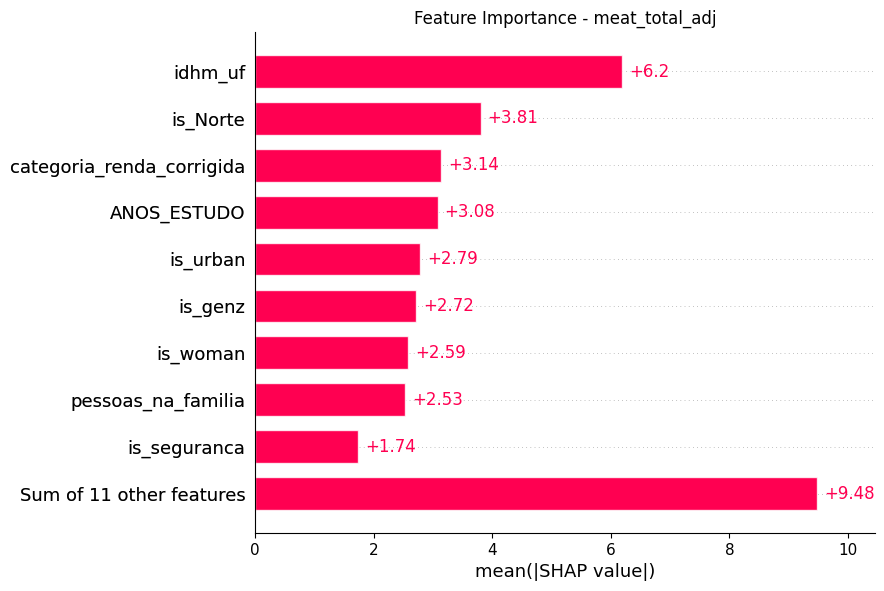

In [51]:
import shap

label = 'meat_total_adj'

X = df[features].copy()
y = df[label].copy()

#scaler = RobustScaler()
#X_tfm= scaler.fit_transform(X)
X_tfm = X.copy().astype(float).values

X_tfm = pd.DataFrame(X_tfm, columns=X.columns)
model = XGBRegressor(random_state=314, n_jobs=-1, verbosity=0)
model.fit(X_tfm, y)

explainer = shap.explainers.Tree(model, X_tfm)
shap_values = explainer(X_tfm)

shap.plots.bar(shap_values, show=False)
plt.title(f'Feature Importance - {label}')
plt.savefig(f'saida/shap_bar_{label}.png', bbox_inches='tight', dpi=300)
plt.show()


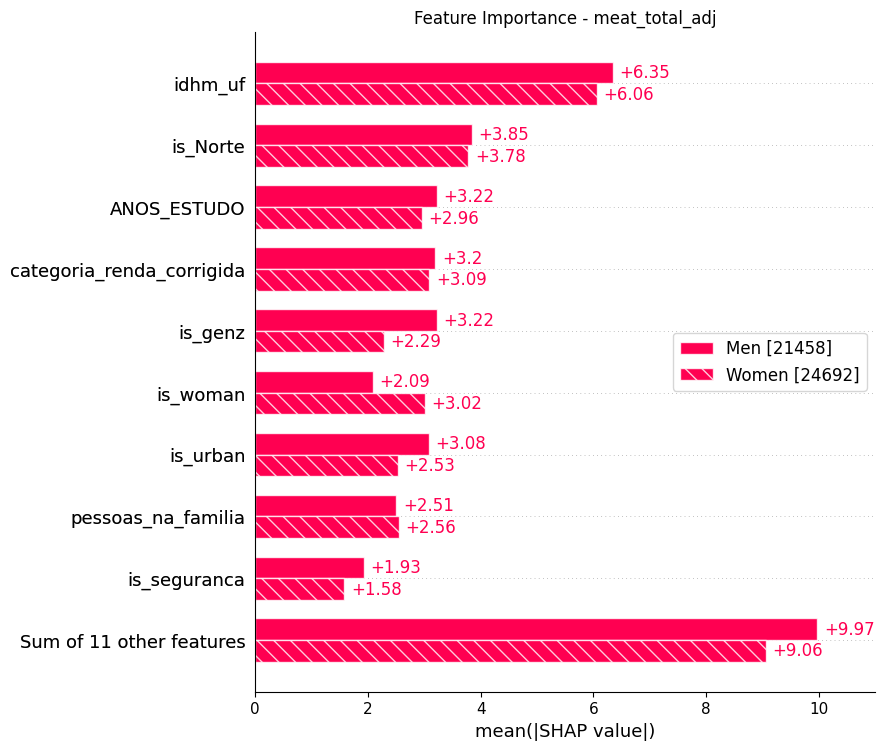

In [52]:
sex = [
    "Women" if shap_values[i, "is_woman"].data == 1 else "Men"
    for i in range(shap_values.shape[0])
]
shap.plots.bar(shap_values.cohorts(sex).abs.mean(0), show=False)
plt.title(f'Feature Importance - {label}')
plt.savefig(f'saida/shap_bar_cohorts_sex_{label}.png', bbox_inches='tight', dpi=300)
plt.show()

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


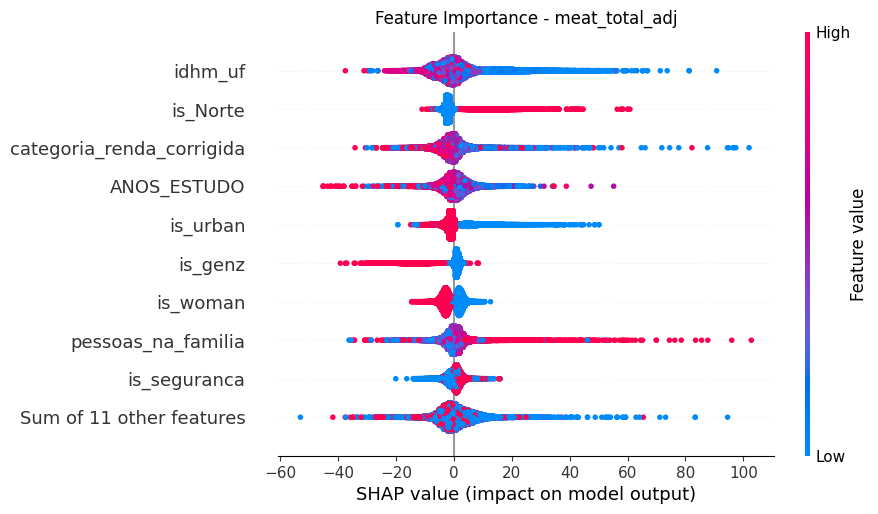

In [53]:
shap.plots.beeswarm(shap_values, show=False)
plt.title(f'Feature Importance - {label}')
plt.savefig(f'saida/shap_beeswarm_{label}.png', bbox_inches='tight', dpi=300)
plt.show()

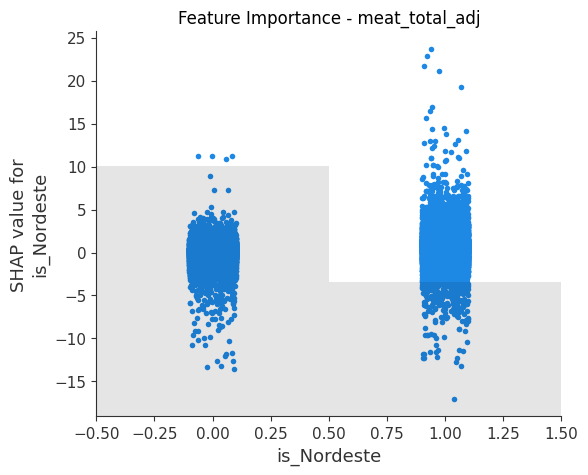

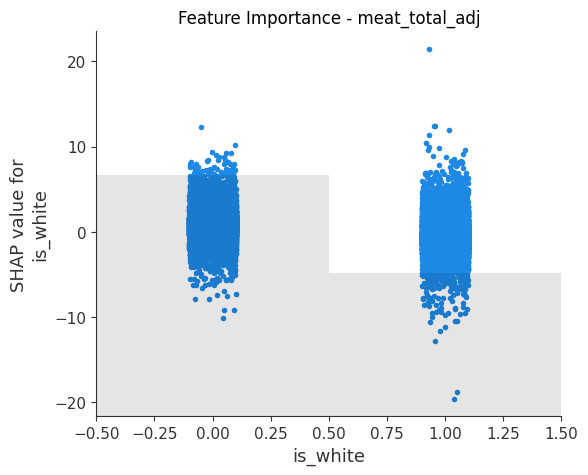

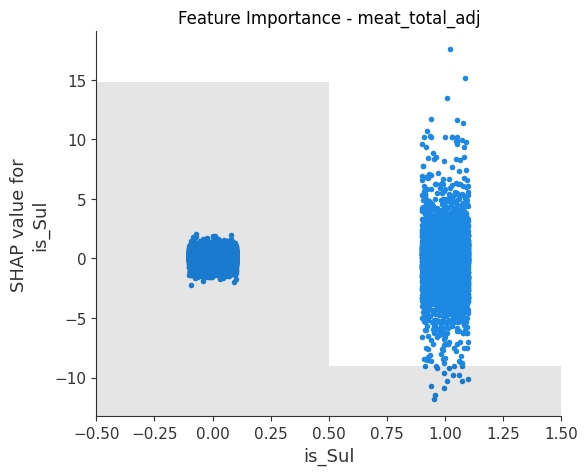

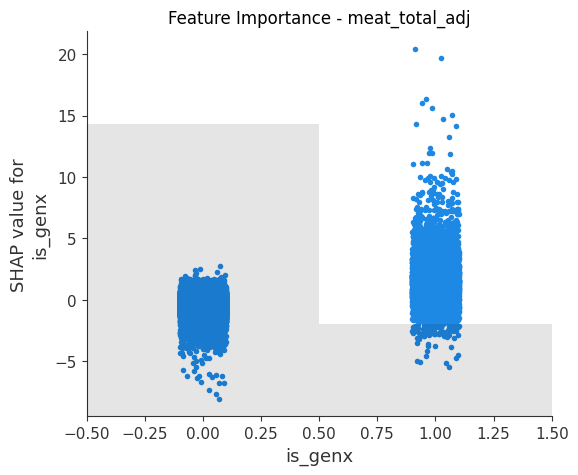

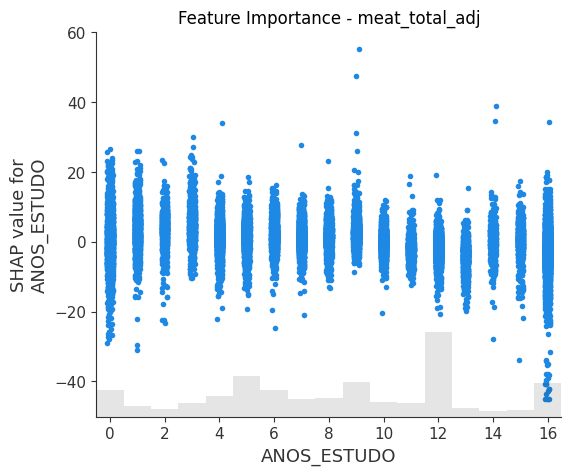

...

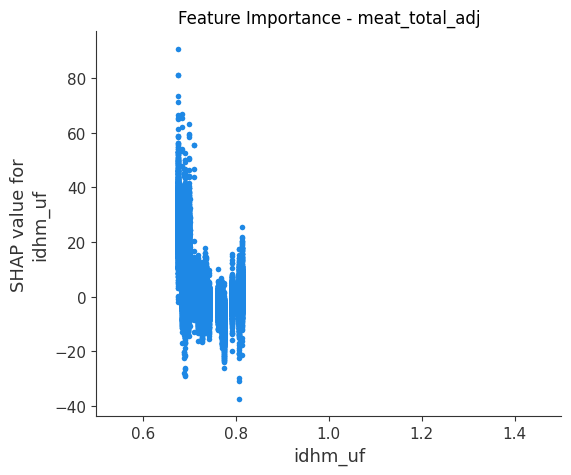

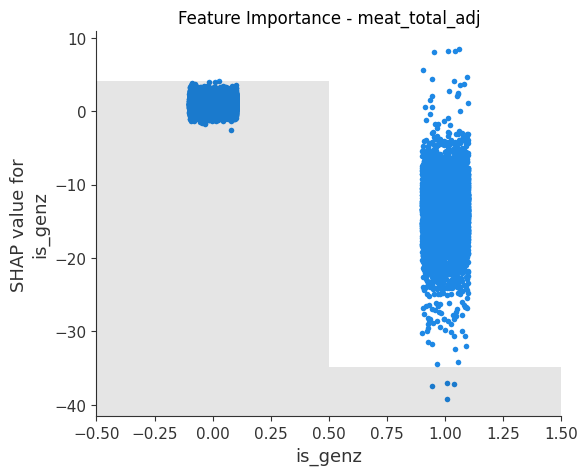

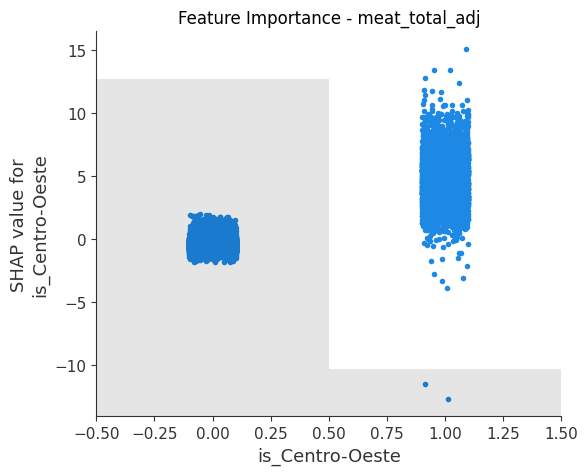

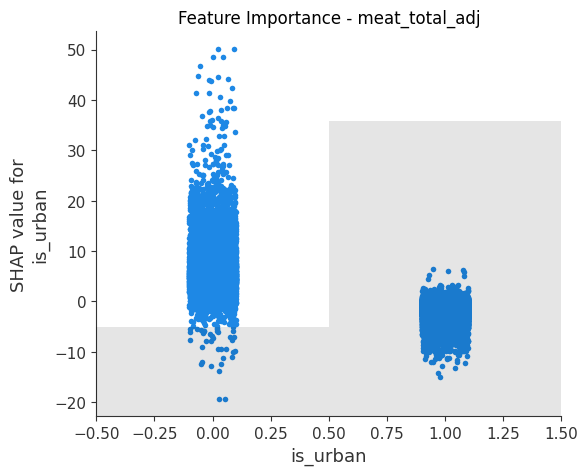

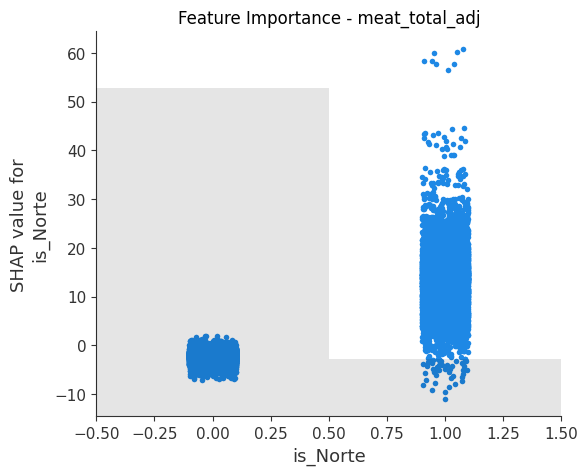

In [54]:
for col in X.columns:
    shap.plots.scatter(shap_values[:,col], show=False)
    plt.title(f'Feature Importance - {label}')
    plt.savefig(f'saida/shap_scatter_{col}_{label}.png', bbox_inches='tight', dpi=300)
    plt.show()
    

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
[16:35:05] WARNING: /workspace/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.
100%|===================| 45932/46150 [02:43<00:00]        

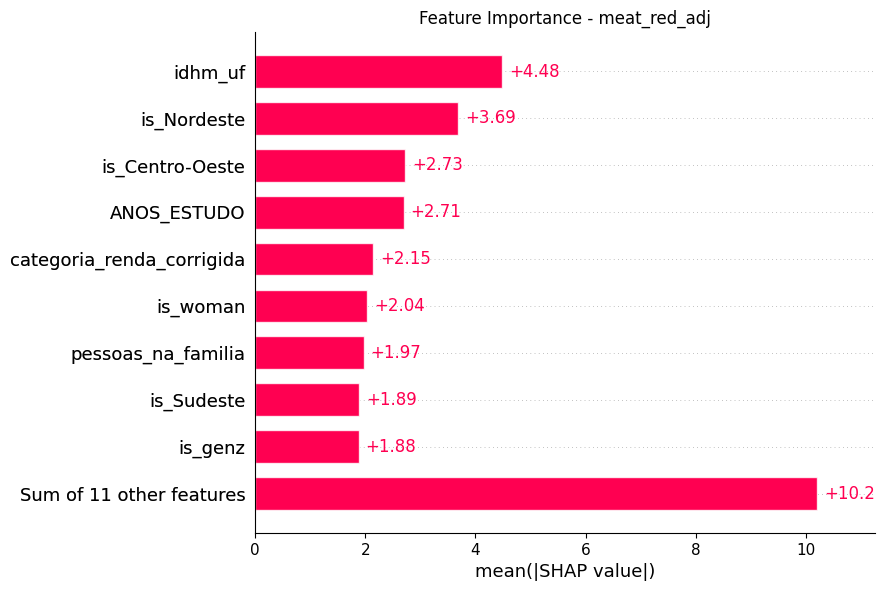

In [55]:
import shap

label = 'meat_red_adj'

X = df[features].copy()
y = df[label].copy()

#scaler = RobustScaler()
#X_tfm= scaler.fit_transform(X)
X_tfm = X.copy().astype(float).values

X_tfm = pd.DataFrame(X_tfm, columns=X.columns)
model = XGBRegressor(random_state=314, n_jobs=-1, verbosity=0)
model.fit(X_tfm, y)

explainer = shap.explainers.Tree(model, X_tfm)
shap_values = explainer(X_tfm)

shap.plots.bar(shap_values, show=False)
plt.title(f'Feature Importance - {label}')
plt.savefig(f'saida/shap_bar_{label}.png', bbox_inches='tight', dpi=300)
plt.show()


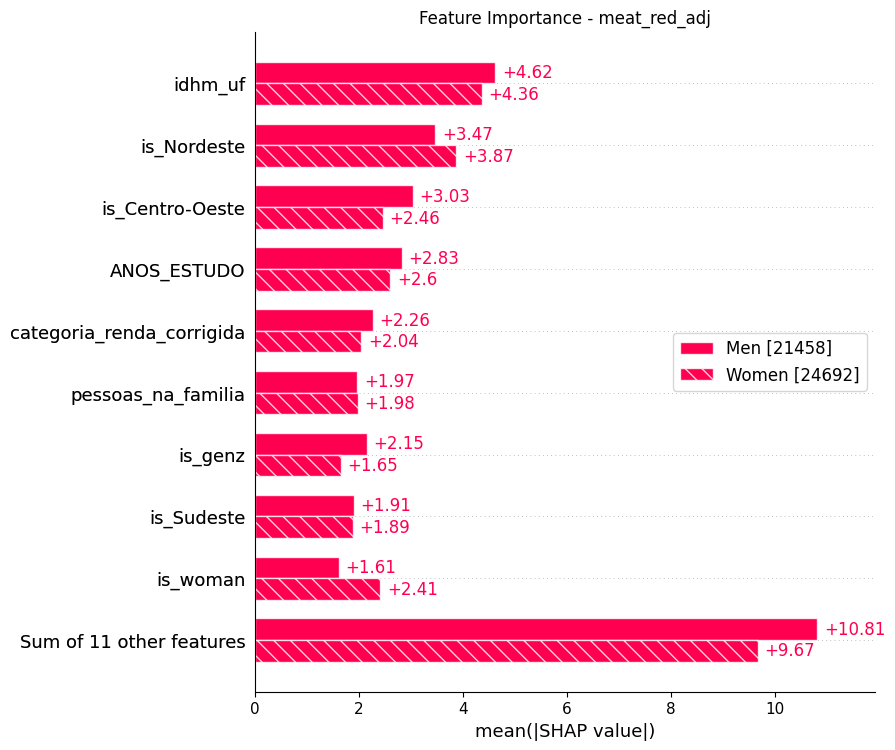

In [56]:
sex = [
    "Women" if shap_values[i, "is_woman"].data == 1 else "Men"
    for i in range(shap_values.shape[0])
]
shap.plots.bar(shap_values.cohorts(sex).abs.mean(0), show=False)
plt.title(f'Feature Importance - {label}')
plt.savefig(f'saida/shap_bar_cohorts_sex_{label}.png', bbox_inches='tight', dpi=300)
plt.show()

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


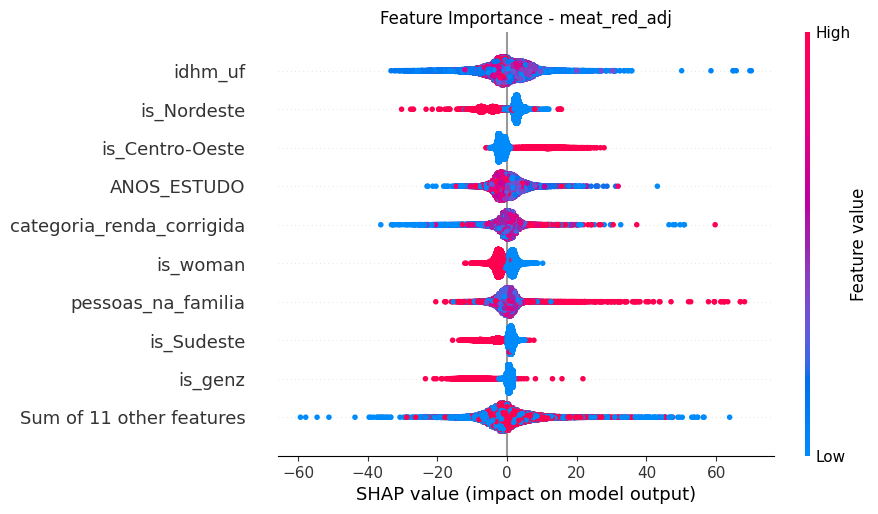

In [57]:
shap.plots.beeswarm(shap_values, show=False)
plt.title(f'Feature Importance - {label}')
plt.savefig(f'saida/shap_beeswarm_{label}.png', bbox_inches='tight', dpi=300)
plt.show()

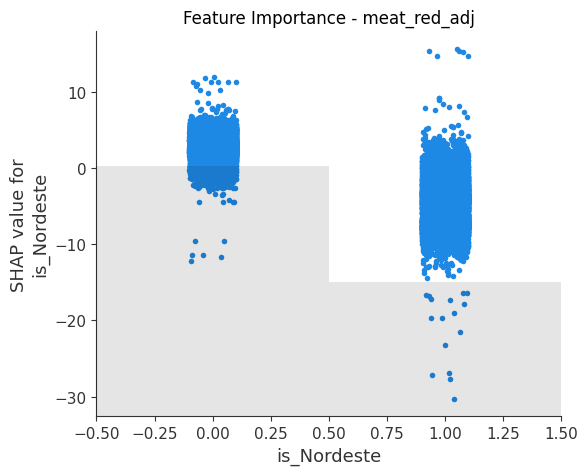

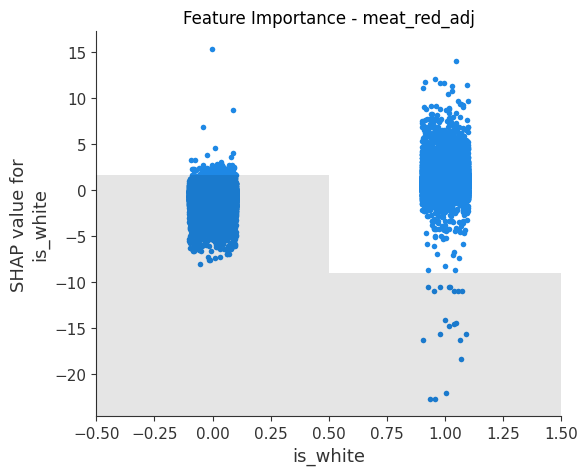

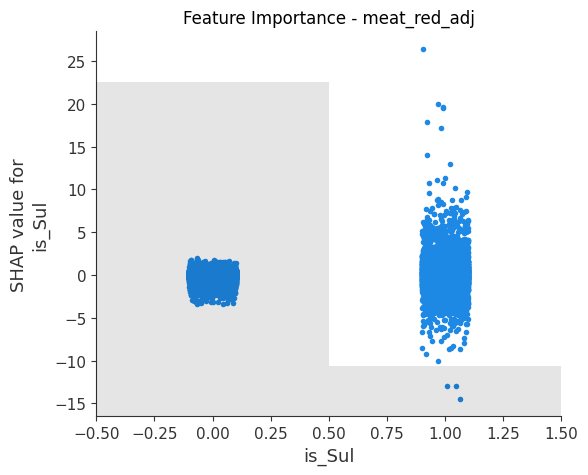

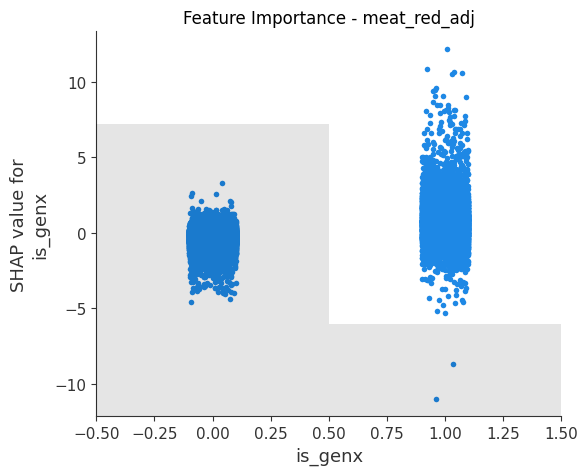

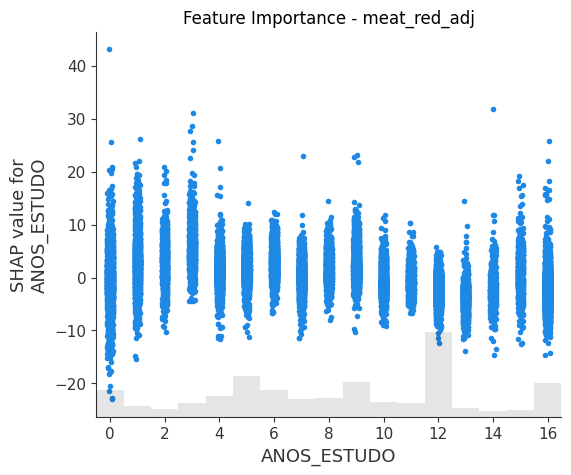

...

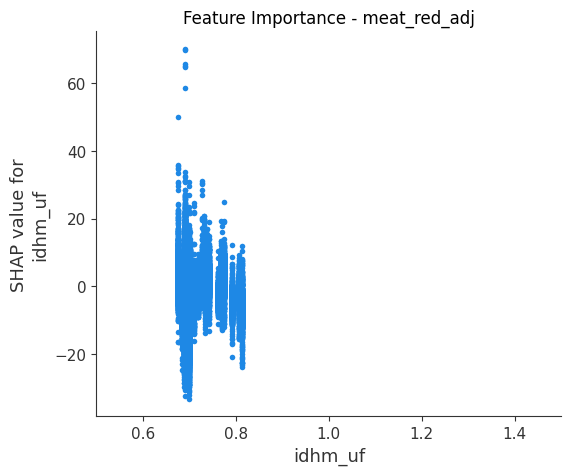

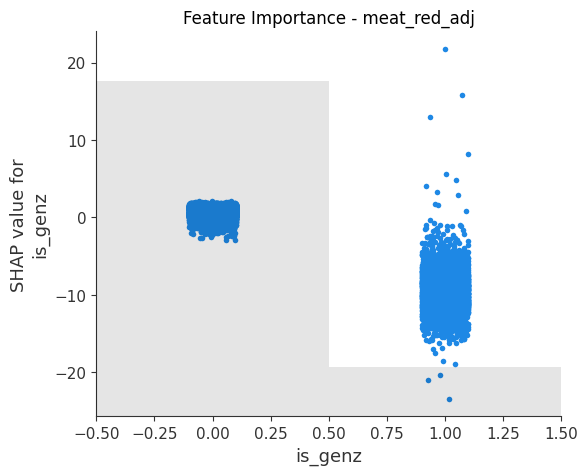

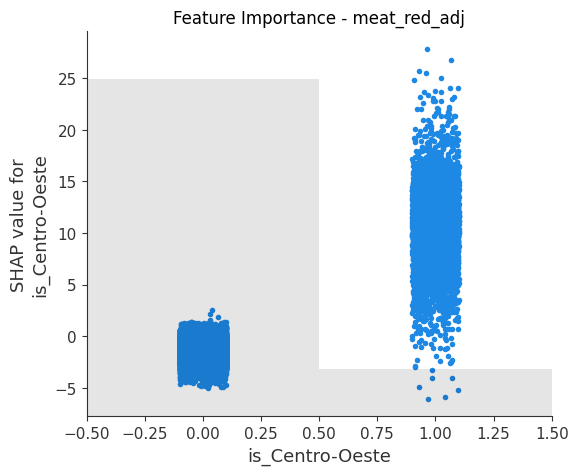

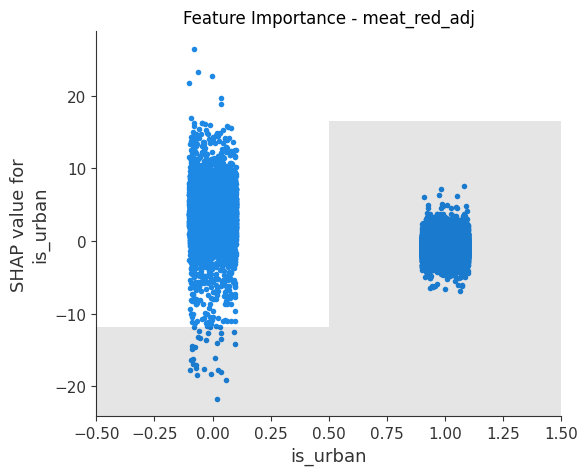

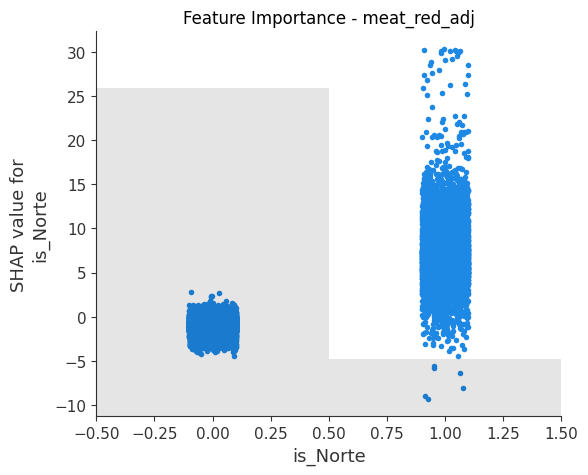

In [58]:
for col in X.columns:
    shap.plots.scatter(shap_values[:,col], show=False)
    plt.title(f'Feature Importance - {label}')
    plt.savefig(f'saida/shap_scatter_{col}_{label}.png', bbox_inches='tight', dpi=300)
    plt.show()
    

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
[16:38:25] WARNING: /workspace/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.
100%|===================| 45973/46150 [02:35<00:00]        

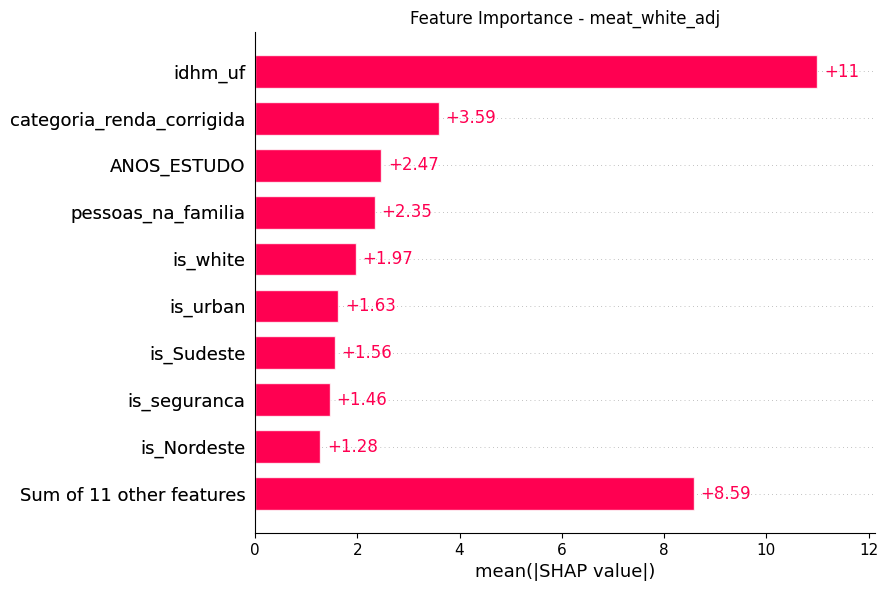

In [59]:
import shap

label = 'meat_white_adj'

X = df[features].copy()
y = df[label].copy()

#scaler = RobustScaler()
#X_tfm= scaler.fit_transform(X)
X_tfm = X.copy().astype(float).values

X_tfm = pd.DataFrame(X_tfm, columns=X.columns)
model = XGBRegressor(random_state=314, n_jobs=-1, verbosity=0)
model.fit(X_tfm, y)

explainer = shap.explainers.Tree(model, X_tfm)
shap_values = explainer(X_tfm)

shap.plots.bar(shap_values, show=False)
plt.title(f'Feature Importance - {label}')
plt.savefig(f'saida/shap_bar_{label}.png', bbox_inches='tight', dpi=300)
plt.show()


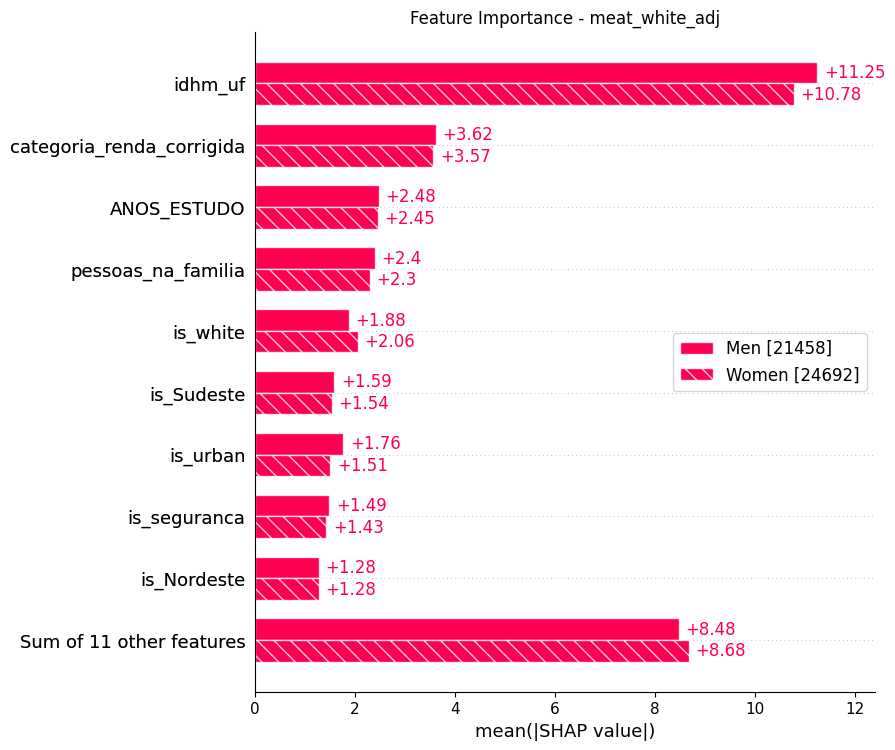

In [60]:
sex = [
    "Women" if shap_values[i, "is_woman"].data == 1 else "Men"
    for i in range(shap_values.shape[0])
]
shap.plots.bar(shap_values.cohorts(sex).abs.mean(0), show=False)
plt.title(f'Feature Importance - {label}')
plt.savefig(f'saida/shap_bar_cohorts_sex_{label}.png', bbox_inches='tight', dpi=300)
plt.show()

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


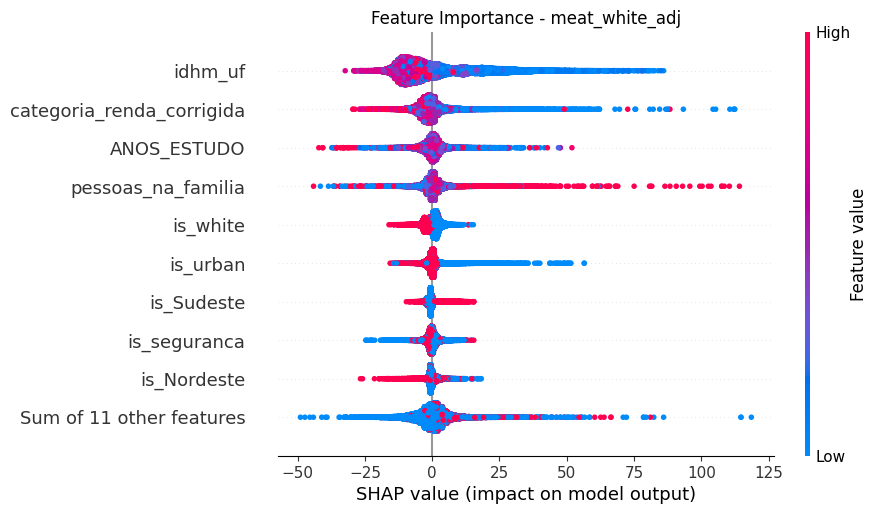

In [61]:
shap.plots.beeswarm(shap_values, show=False)
plt.title(f'Feature Importance - {label}')
plt.savefig(f'saida/shap_beeswarm_{label}.png', bbox_inches='tight', dpi=300)
plt.show()

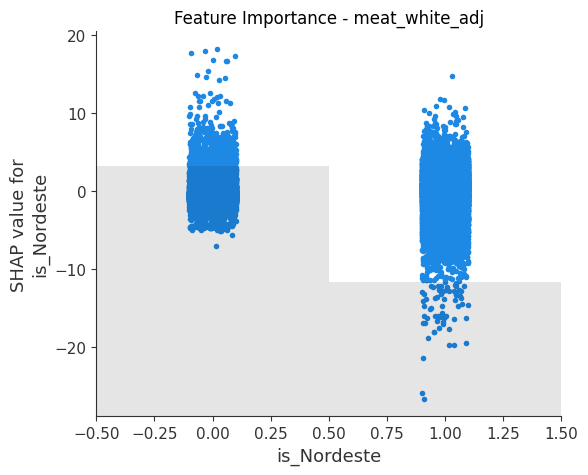

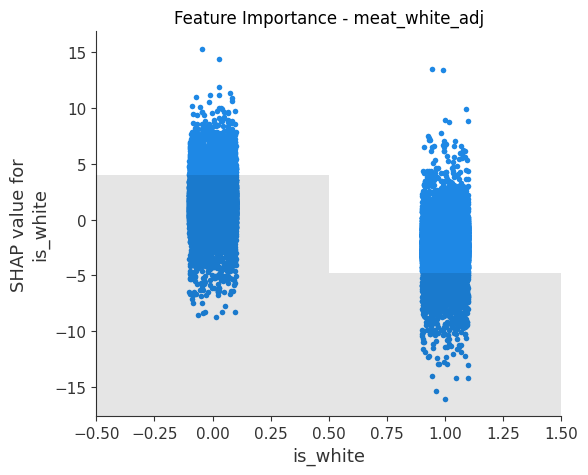

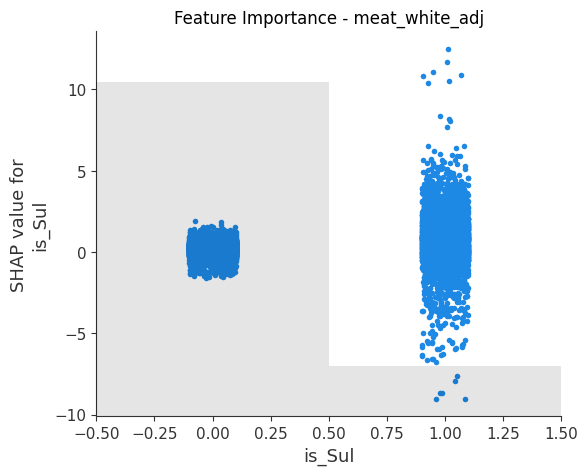

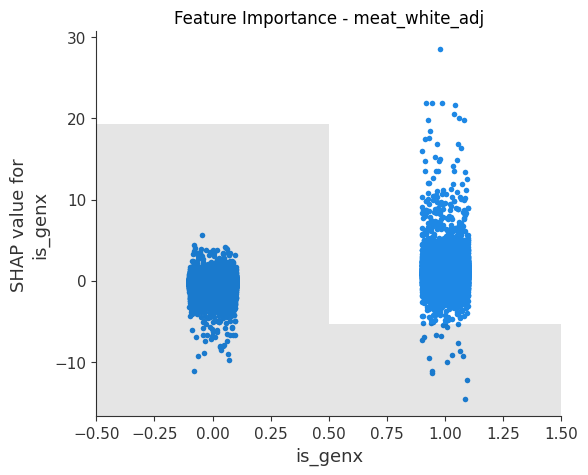

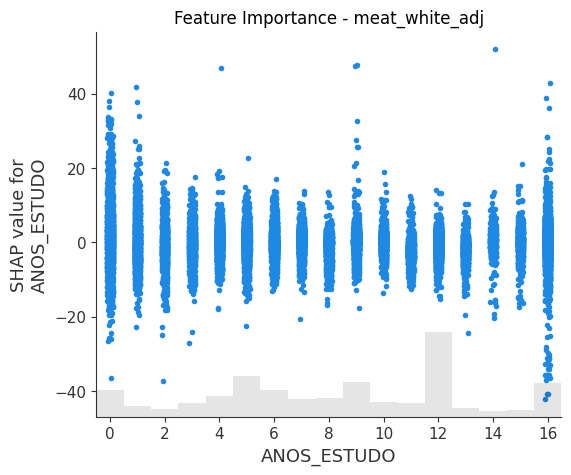

...

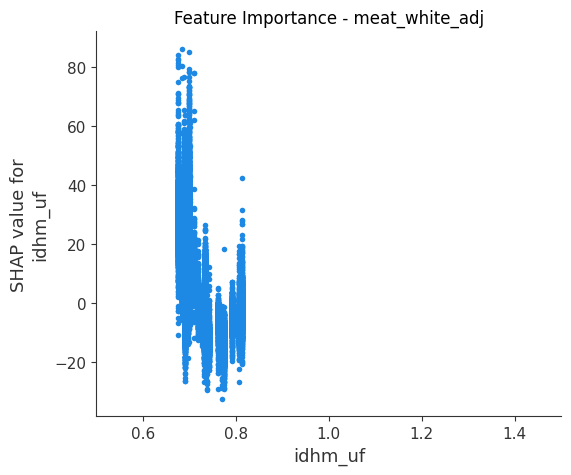

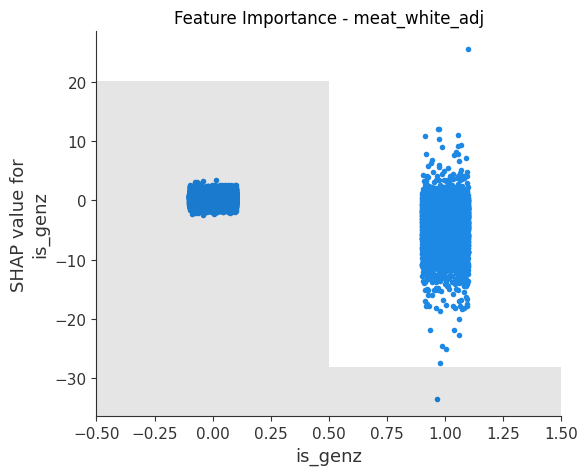

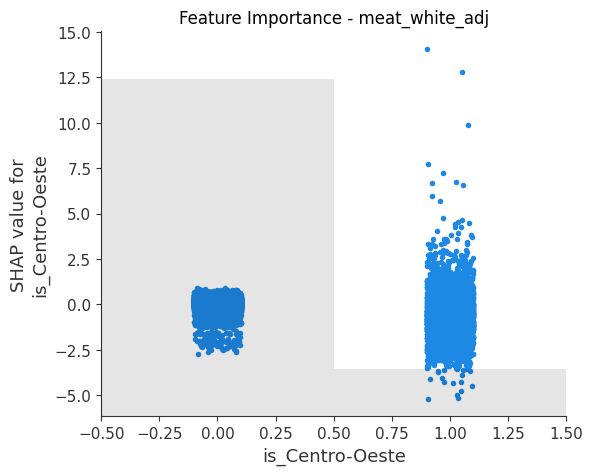

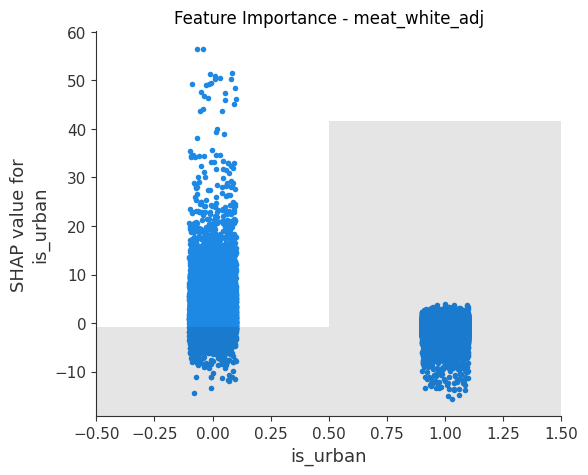

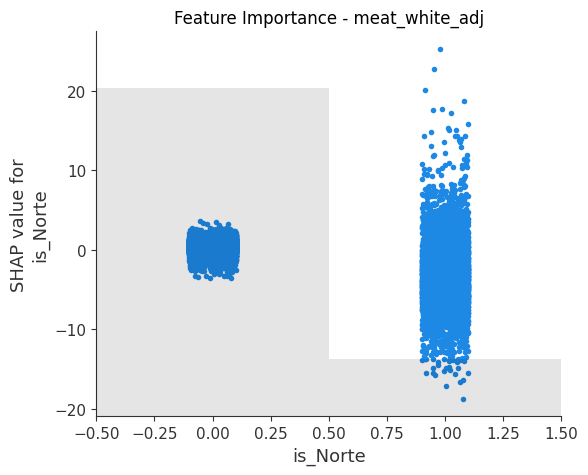

In [62]:
for col in X.columns:
    shap.plots.scatter(shap_values[:,col], show=False)
    plt.title(f'Feature Importance - {label}')
    plt.savefig(f'saida/shap_scatter_{col}_{label}.png', bbox_inches='tight', dpi=300)
    plt.show()
    

<Axes: >

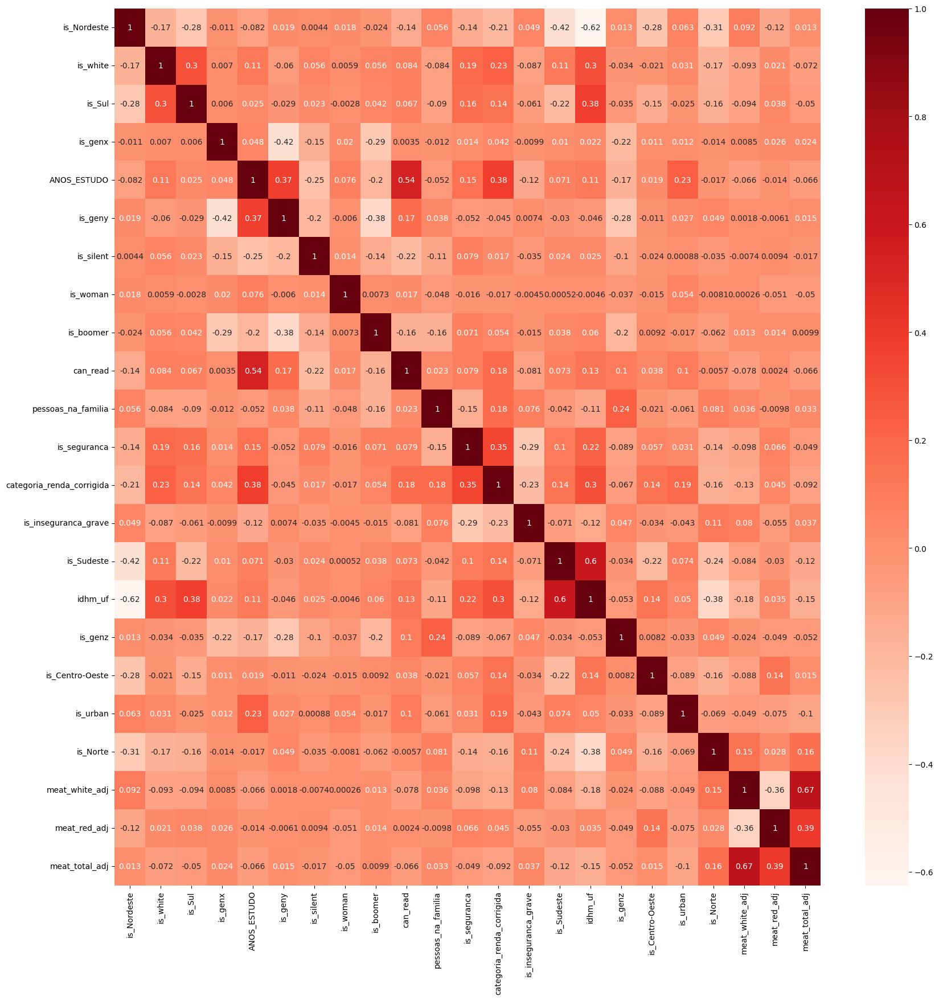

In [63]:
# plot a heatmap with a correlation between features 



corr = df[features + labels].corr()

plt.figure(figsize=(20, 20))
sns.heatmap(corr, annot=True, cmap=plt.cm.Reds)



In [64]:
# plot a heatmap with a correlation between features using plotly


corr = df[features + labels].corr()

fig = px.imshow(corr)
fig.show()


In [65]:
# plot a correlogram with plotly

fig = px.scatter_matrix(df[features], width=1000, height=1000)
fig.update_traces(diagonal_visible=False)
fig.show()


In [ ]:
### TEST

In [ ]:


X = df[features].copy().astype(float).values
y = df[labels[-1]].copy()

y = MinMaxScaler().fit_transform(y.values.reshape(-1, 1))
y = y.reshape(-1)


X = RobustScaler().fit_transform(X)

model = GradientBoostingRegressor(random_state=314)
model.fit(X, y)


In [ ]:
# get feature importance
feature_importance = model.feature_importances_
feature_importance = 100.0 * (feature_importance / feature_importance.max())
sorted_idx = np.argsort(feature_importance)[::-1]
sorted_idx

In [ ]:
labels[-1]

In [ ]:
for i in sorted_idx:
    print(f'{features[i]}: {feature_importance[i]:.2f}')
    